## # <span style="color:red; font-style:italic; text-decoration:underline;"># Notebook contents</span>
A) - data  preprocessing</span>
 * 1) - Egalization of the Histogramme </span>
 * 2) - Choosing a data sample for preliminary processing before delving into the entire dataset is a wise approach.
 * 3) - Contrast Enhancement.
 * 4) - Convert the color of the images to grayscale. 
 * 5) - Elimination of noise. 
 * 7) - Histogram Equalization . 
 * 8) - quantization of the images . 


B) - Edge detection . 
 * a) - Laplacian of Gaussian (LoG) Filter
 * b) - The Sobel Operator 
 * c) - morphological_edge_detection
 * d) - Canny edge detection

c) - Image Segmentation
 * 1) - threshold_adaptive_adaptative_segmantation 
 * 2) - Otsu_Thresholding segmentation 
 * 3) - region_growing segmentation 
 * 4) - k-Means Clustering_Segmentation
 * 5) - segment_by_color_hsv 

C) - the result-testing 

In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter
from matplotlib.gridspec import GridSpec
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter
from matplotlib.gridspec import GridSpec
import tensorflow 
import keras  
import os
import glob 
from skimage import io 
import random 
import numpy as np
import matplotlib.pyplot as plt  
%matplotlib inline

In [3]:
def  desplay_list_images(num_cols,image_files , path):
    num_rows = 2
    num_cols = len(image_files) // num_rows
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 6))
    for i, image_file in enumerate(image_files):
        row = i // num_cols
        col = i % num_cols
        image_path = os.path.join(path, image_file)
        image = cv2.imread(image_path)

        # Display the image in the corresponding subplot
        axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
        axes[row, col].set_title(image_file)
        axes[row, col].axis('off')  # Turn off axis labels
    return 'Done'
def read_image(path, image_file):
    image_path = os.path.join(path, image_file)
    return  cv2.imread(image_path)
def display_image(images, title):
    fig, axes = plt.subplots(1, len(images), figsize=(10, 5))
    i= 0
    for image in images :
        axes[i].imshow(image)
        axes[i].set_title(title)
        axes[i].axis('off')
        i= i+1
    plt.show()
    return  'done'


In [5]:
healthy_br_path = 'data_brain/no'
sick_br_path = 'data_brain/yes'
healthy_br_images = [f for f in os.listdir(healthy_br_path) if f.endswith(('.jpg', '.png', '.jpeg', '.gif'))]
sick_br_images = [f for f in os.listdir(sick_br_path) if f.endswith(('.jpg', '.png', '.jpeg', '.gif'))]
num_rows = 2
num_cols = len(sick_br_images) // num_rows

# <span style="color:red; font-style:italic; text-decoration:underline;"># A) - data  preprocessing</span>

## <span style="color:green; font-style:italic; text-decoration:underline;"> 1) -Egalization of the Histogramme </span>

###  <span style="color:blue; font-style:italic; "> - let's explore the Red-Green-Blue channels of our original image;</span>

Text(0.5, 0.98, 'Original & RGB image channels')

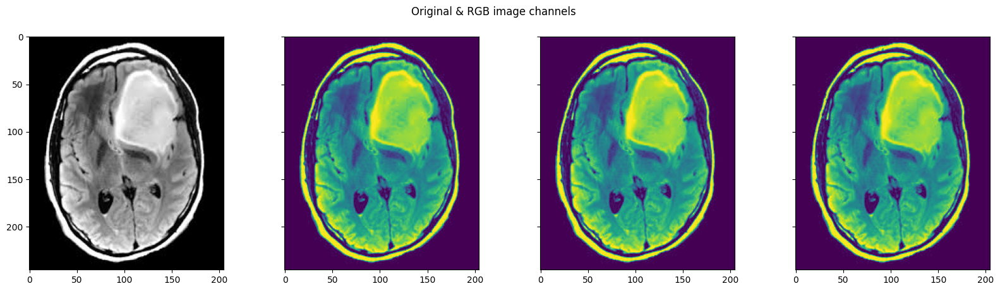

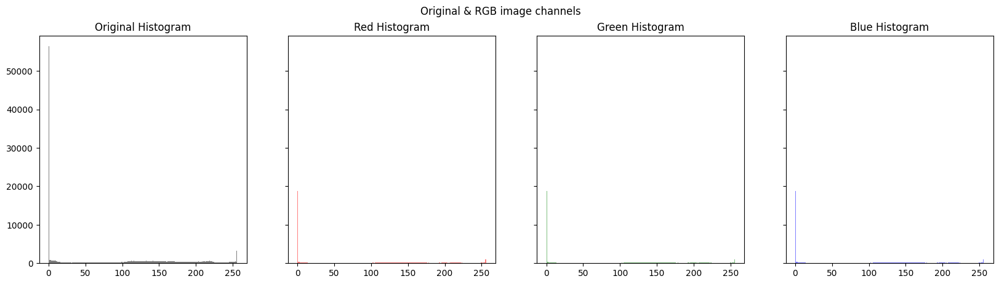

In [6]:
# plotting the original image and the RGB channels 
image = io.imread(sick_br_path +'/'+ sick_br_images [6])  
i, (im1, im2, im3, im4) = plt.subplots(1, 4, sharey=True)
i.set_figwidth(20) 
im1.imshow(image)  #Original image
im2.imshow(image[:, : , 0]) #Red
im3.imshow(image[:, : , 1]) #Green
im4.imshow(image[:, : , 2]) #Blue
i.suptitle('Original & RGB image channels')
# plotting the original image and the RGB channels 
image = io.imread(sick_br_path +'/'+ sick_br_images [6])  
i, (hist1, hist2, hist3, hist4) = plt.subplots(1, 4, sharey=True)
i.set_figwidth(20) 
# Histograms
hist1.hist(image.ravel(), bins=256, range=(0, 256), color='k', alpha=0.5)
hist1.set_title('Original Histogram')

hist2.hist(image[:, :, 0].ravel(), bins=256, range=(0, 256), color='r', alpha=0.5)
hist2.set_title('Red Histogram')

hist3.hist(image[:, :, 1].ravel(), bins=256, range=(0, 256), color='g', alpha=0.5)
hist3.set_title('Green Histogram')
hist3.set_facecolor('w')  # Set white background for the green histogram

hist4.hist(image[:, :, 2].ravel(), bins=256, range=(0, 256), color='b', alpha=0.5)
hist4.set_title('Blue Histogram')
i.suptitle('Original & RGB image channels')

Text(0.5, 0.98, 'Original & RGB image channels')

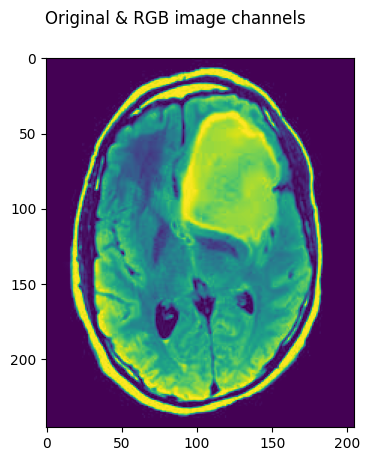

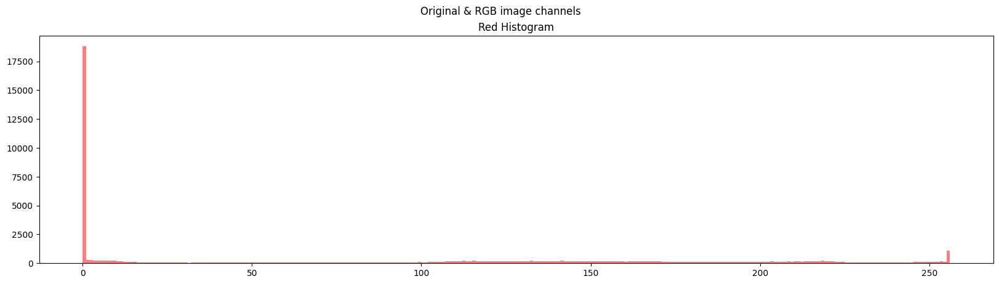

In [7]:
# plotting the original image and the RGB channels 
image = io.imread(sick_br_path +'/'+ sick_br_images [6])  
i, (im2) = plt.subplots(1, 1, sharey=True)
i.set_figwidth(20) 
im2.imshow(image[:, : , 0]) #Red
i.suptitle('Original & RGB image channels')
# plotting the origina*l image and the RGB channels
i, ( hist2) = plt.subplots(1, 1, sharey=True)
i.set_figwidth(20) 
# Histograms
hist2.hist(image[:, :, 0].ravel(), bins=256, range=(0, 256), color='r', alpha=0.5)
hist2.set_title('Red Histogram')
i.suptitle('Original & RGB image channels')

Text(0.5, 0.98, 'Original & RGB image channels')

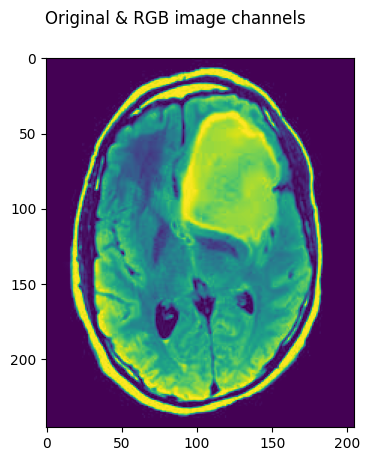

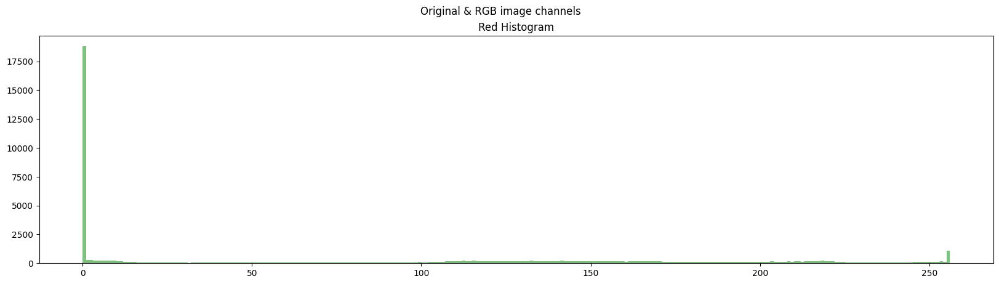

In [49]:
# plotting the original image and the RGB channels 
image = io.imread(sick_br_path +'/'+ sick_br_images [6])  
i, (im2) = plt.subplots(1, 1, sharey=True)
i.set_figwidth(20) 
im2.imshow(image[:, : , 1]) #green
i.suptitle('Original & RGB image channels')
# plotting the original image and the RGB channels
i, ( hist2) = plt.subplots(1, 1, sharey=True)
i.set_figwidth(20) 
# Histograms
hist2.hist(image[:, :, 1].ravel(), bins=256, range=(0, 256), color='g', alpha=0.5)
hist2.set_title('Red Histogram')
i.suptitle('Original & RGB image channels')

Text(0.5, 0.98, 'Original & RGB image channels')

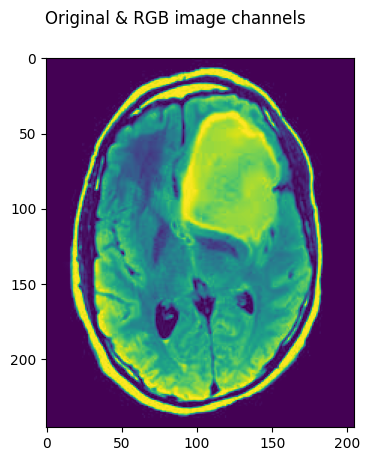

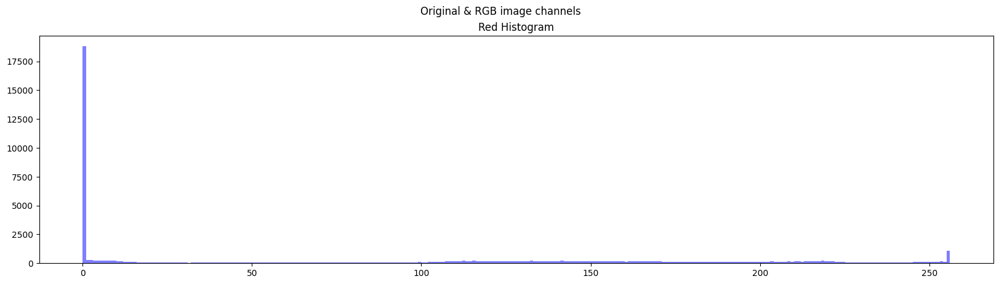

In [37]:
# plotting the original image and the RGB channels 
image = io.imread(sick_br_path +'/'+ sick_br_images [6])  
i, (im2) = plt.subplots(1, 1, sharey=True)
i.set_figwidth(20) 
im2.imshow(image[:, : , 2]) # blue
i.suptitle('Original & RGB image channels')
# plotting the original image and the RGB channels
i, ( hist2) = plt.subplots(1, 1, sharey=True)
i.set_figwidth(20) 
# Histograms
hist2.hist(image[:, :, 2].ravel(), bins=256, range=(0, 256), color='b', alpha=0.5)
hist2.set_title('Red Histogram')
i.suptitle('Original & RGB image channels')

## <span style="color:green; font-style:italic; text-decoration:underline;"> 1) - display a sample of our  data </span>

###  <span style="color:blue; font-style:italic; "> - The dataset being used in this notebook pertains to brain tumors and consists of two classes: one representing a healthy brain and the other indicating a diseased brain with a tumor.</span>

 display healthy brain images -----------------------------------------------------------------


'Done'

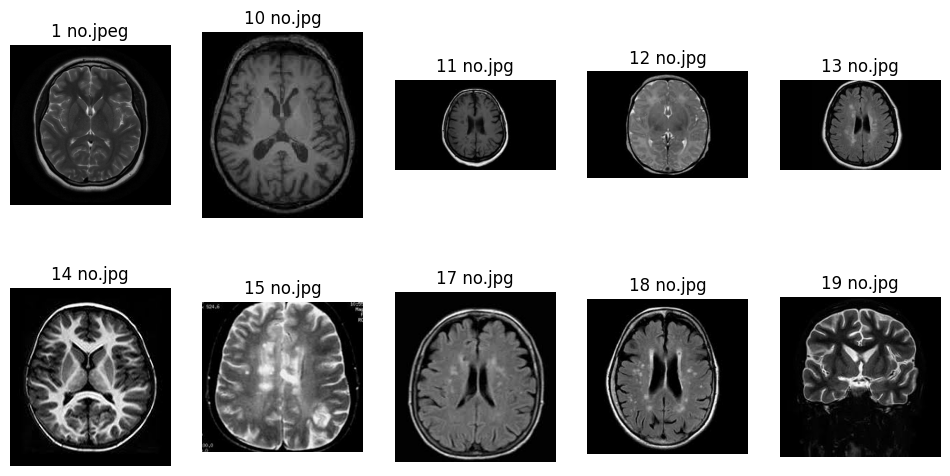

In [83]:
print(' display healthy brain images -----------------------------------------------------------------')
desplay_list_images(num_cols,healthy_br_images[:10],healthy_br_path)

 display sick brain images -----------------------------------------------------------------


'Done'

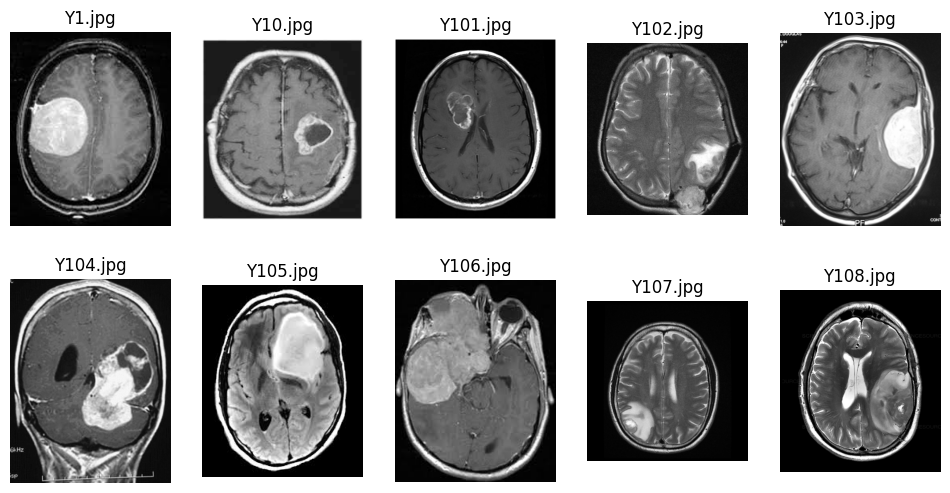

In [7]:
print(' display sick brain images -----------------------------------------------------------------')
desplay_list_images(num_cols,sick_br_images[:10] , sick_br_path)

## <span style="color:green; font-style:italic; text-decoration:underline;"> 2) -Choosing a data sample for preliminary processing before delving into the entire dataset is a wise approach.</span>

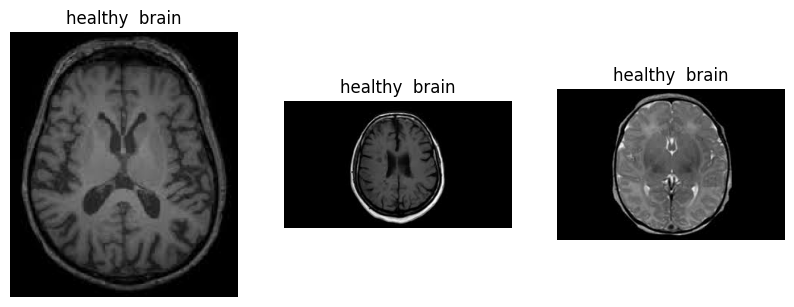

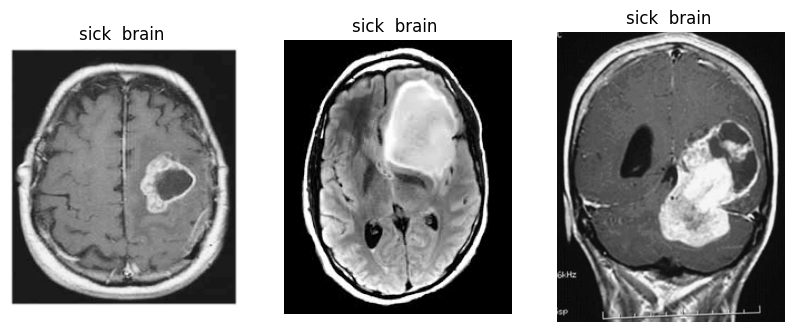

'done'

In [134]:
h_1 = read_image(healthy_br_path , healthy_br_images[1])
h_2 = read_image(healthy_br_path , healthy_br_images[2])
h_3 = read_image(healthy_br_path , healthy_br_images[3])
h_images = [h_1 ,h_2,h_3]
display_image(h_images, 'healthy  brain')


s_1 = read_image(sick_br_path , sick_br_images[1])
s_2 = read_image(sick_br_path , sick_br_images[6])
s_3 = read_image(sick_br_path , sick_br_images[5])
s_images = [s_1 ,s_2,s_3]
display_image(s_images, 'sick  brain ')

###  <span style="color: green ; font-style:italic; "> 3)- Contrast Enhancement: </span>

In [135]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
from matplotlib.gridspec import GridSpec

def contrast(images):
    enhanced_images = []
    for image in images:
        enhanced_image = exposure.equalize_hist(image)
        enhanced_images.append(enhanced_image)
    return enhanced_images

def apply_contrast_enhancement_and_display(images):
    enhanced_images = []
    for image in images:
        enhanced_image = exposure.equalize_hist(image)
        enhanced_images.append(enhanced_image)
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and enhanced)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try  :
        for i in range(num_images):
            row, col = divmod(i, num_cols)
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(enhanced_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title("Enhanced")

        plt.tight_layout()
    except : pass
    plt.show()

###  <span style="color:orange ; font-style:italic; "> ---- > Adjust the contrast and brightness of healthy brain images : </span>

C:\Users\dell\AppData\Roaming\Python\Python310\site-packages\skimage\_shared\utils.py:316: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


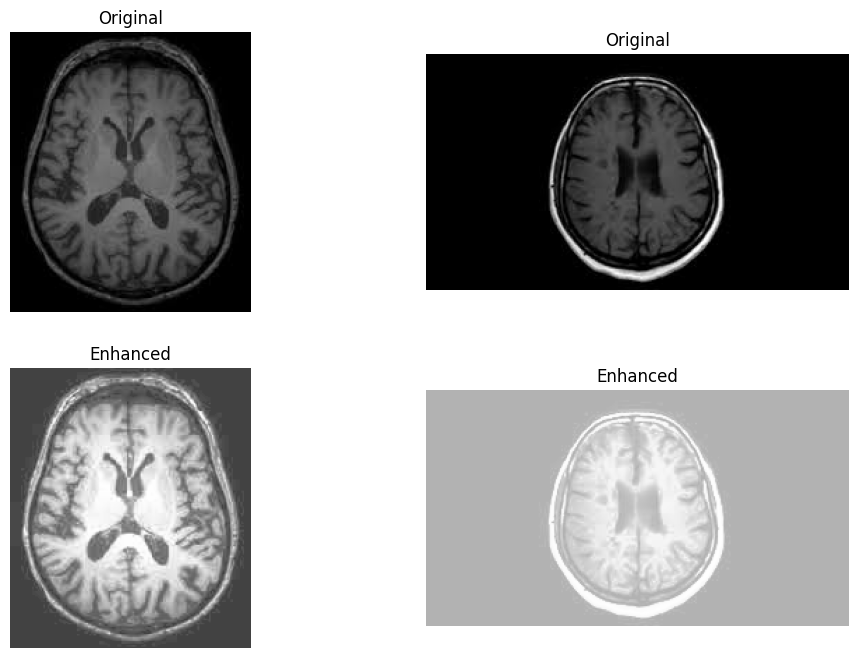

In [136]:
apply_contrast_enhancement_and_display(h_images)

###  <span style="color:orange ; font-style:italic; "> ---- > Adjust the contrast and brightness of sick brain images : </span>

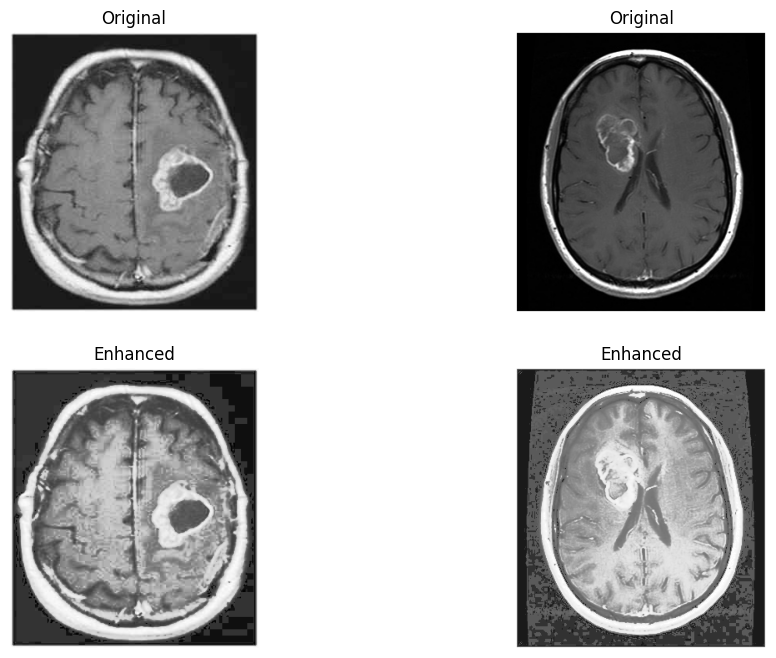

In [183]:
apply_contrast_enhancement_and_display(s_images)

In [11]:
h_images = contrast(h_images)
s_images = contrast(s_images)

C:\Users\dell\AppData\Roaming\Python\Python310\site-packages\skimage\_shared\utils.py:316: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


## <span style="color:green; font-style:italic; text-decoration:underline;"> 4) - Convert the color of the images to grayscale. </span>

###  <span style="color:blue; font-style:italic; "> The function will convert each color image to grayscale and display them side by side in a table format</span>

In [154]:


def convert_and_display_grayscale_images(image_list):
    grayscale_images = []

    for color_image in image_list:
        grayscale_image = np.dot(color_image[..., :3], [0.5989, 0.5870, 0.5140])
        grayscale_images.append(grayscale_image)
    num_images = len(image_list)
    fig, axes = plt.subplots(2, num_images, figsize=(4 * num_images, 8))

    for i in range(num_images):
        axes[0, i].imshow(image_list[i])
        axes[0, i].set_title("Original")
        axes[1, i].imshow(grayscale_images[i], cmap='gray')
        axes[1, i].set_title("Grayscale")
        axes[1, i].axis('off')

    plt.show()


###  <span style="color:orange ; font-style:italic; "> ---- > the  grayscale images of healthy  brain images : </span>

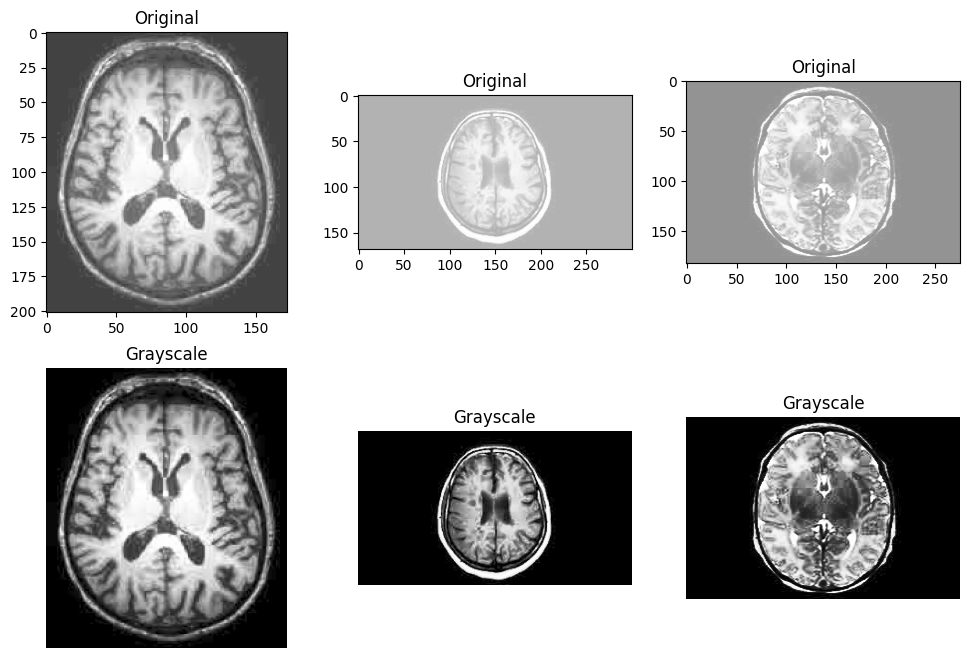

In [187]:
convert_and_display_grayscale_images(h_images)

###  <span style="color:orange ; font-style:italic; "> ---- > the  grayscale images of sick brain images : </span>

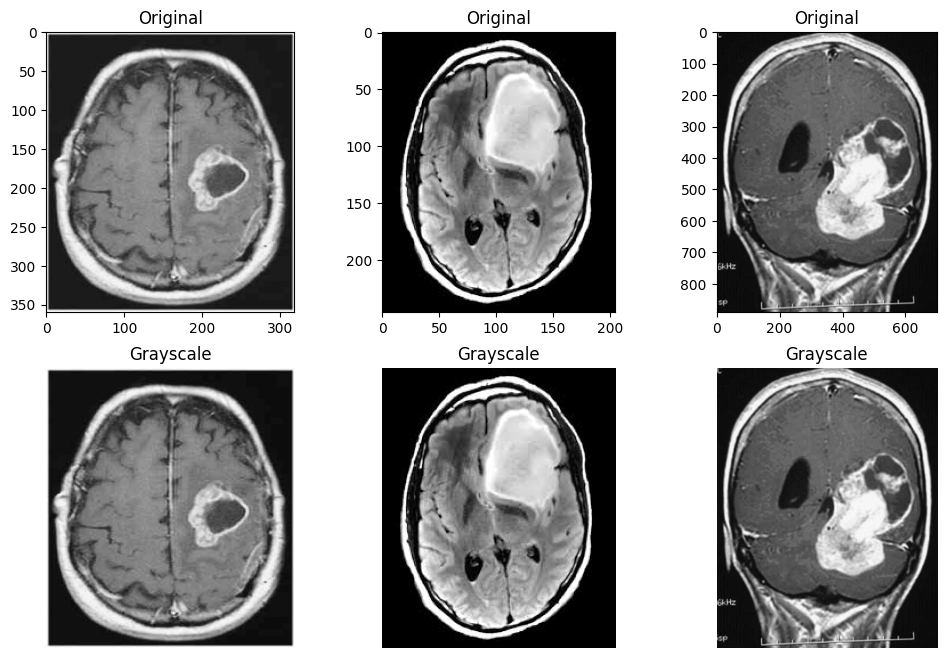

In [155]:
convert_and_display_grayscale_images(s_images)

###  <span style="color:blue ; font-style:italic; "> ---- > It appears that transforming the original images into grayscale images could potentially assist in identifying the image contours. </span>

## <span style="color:green; font-style:italic; text-decoration:underline;"> 5) - Elimination of noise. </span>

## <span style="color:brown ; font-style:italic; text-decoration:underline;"> -- a) - Mean filter </span>

In [189]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import uniform_filter
from matplotlib.gridspec import GridSpec

def Mean_filter(images, size=3):
    filtered_images = []
    for image in images:
        filtered_image = uniform_filter(image, size=size)
        filtered_images.append(filtered_image)
    return filtered_images

def apply_mean_filter_and_display(images, size=4):
    filtered_images = []
    for image in images:
        filtered_image = uniform_filter(image, size=size)
        filtered_images.append(filtered_image)
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and filtered)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try  :
        for i in range(num_images):
            row, col = divmod(i, num_cols)
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(filtered_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title("Filtered (Mean)")

        plt.tight_layout()
    except : pass
    plt.show()


###  <span style="color:orange ; font-style:italic; "> ---- > applaying  the mean_filter on healthy images : </span>

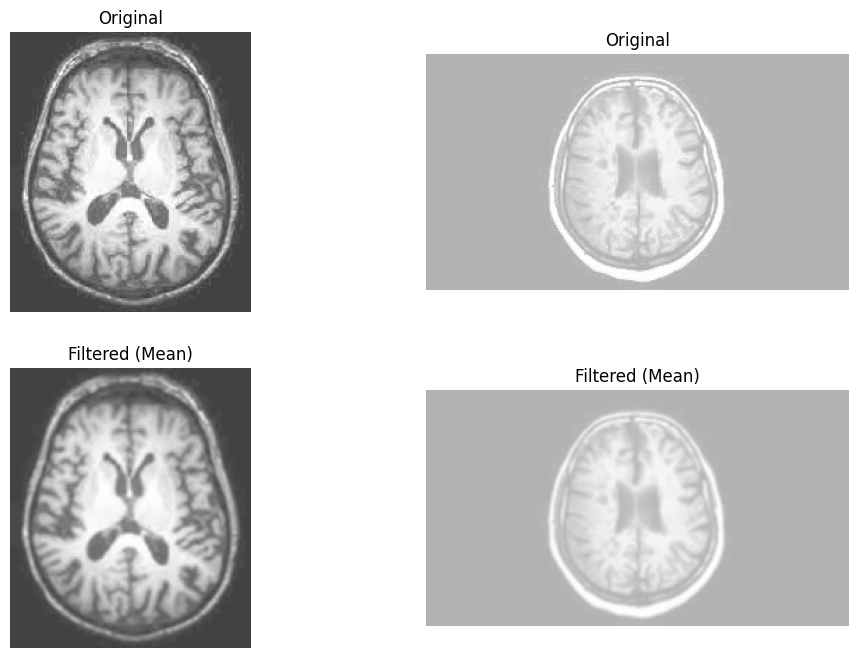

In [190]:
apply_mean_filter_and_display(h_images, size=3)

###  <span style="color:orange ; font-style:italic; "> ---- > applaying  the mean_filter on sick brain images : </span>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


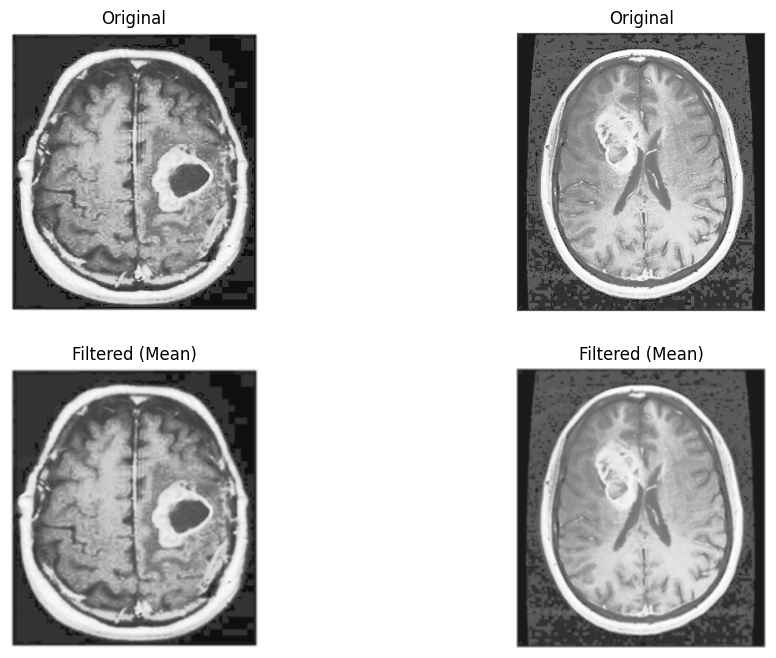

In [191]:
apply_mean_filter_and_display(s_images, size=3)

## <span style="color:brown ; font-style:italic; text-decoration:underline;"> -- b) -gaussian_filter </span>

In [152]:
def gaussian_filter_images(images, sigma=1):
    filtered_images = []
    for image in images:
        filtered_image = gaussian_filter(image, sigma=sigma)
        filtered_images.append(filtered_image)
    return filtered_images 

def apply_gaussian_filter_and_display(images, sigma=1):
    filtered_images = []
    for image in images:
        filtered_image = gaussian_filter(image, sigma=sigma)
        filtered_images.append(filtered_image)
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and filtered)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows
    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try :
        for i in range(num_images):
            row, col = divmod(i, num_cols)
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(filtered_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title("Filtered (Gaussian)")
        plt.tight_layout()
    except  :pass
    plt.show()

###  <span style="color:orange ; font-style:italic; "> ---- > applaying  the gaussian_filter on healthy images : </span>

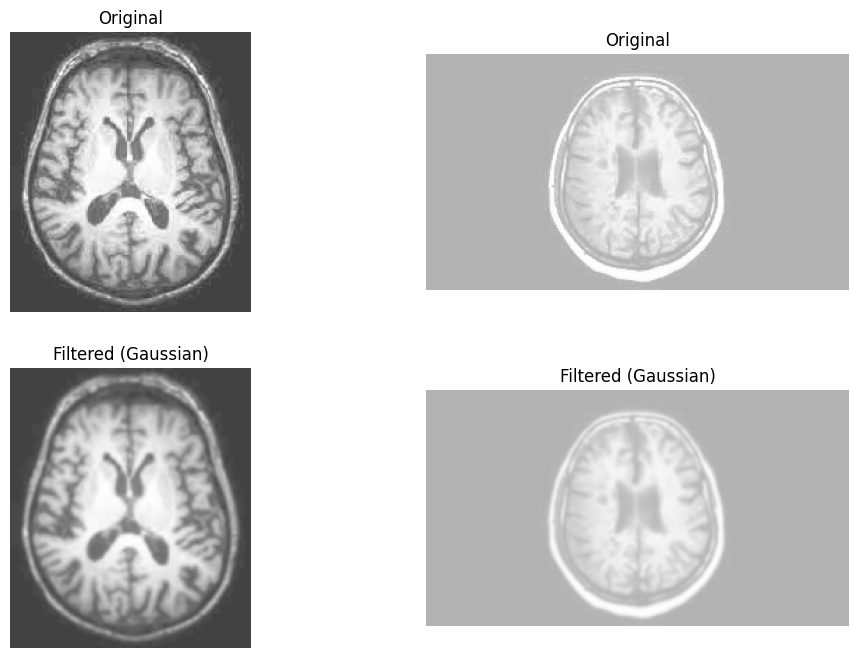

In [192]:
apply_gaussian_filter_and_display(h_images, sigma=1)

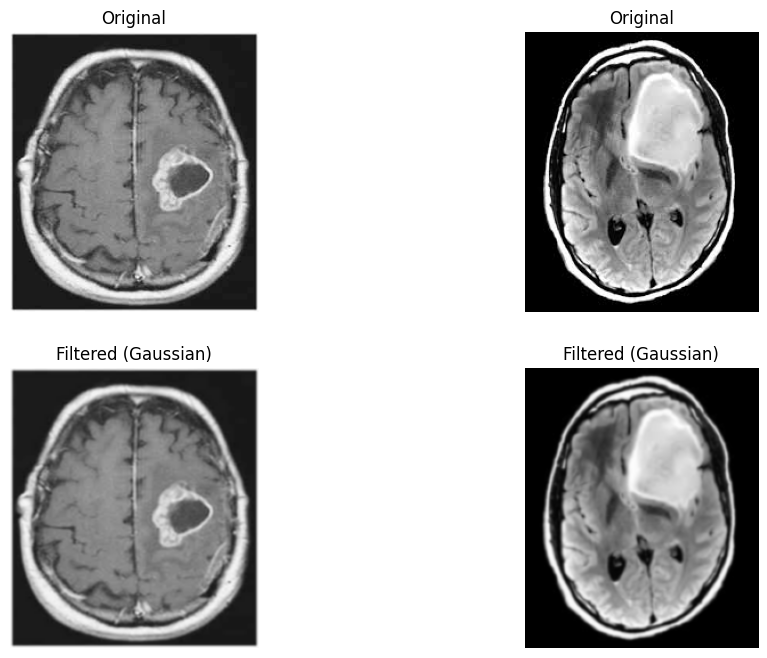

In [153]:
apply_gaussian_filter_and_display(s_images, sigma=1)

## <span style="color:brown ; font-style:italic; text-decoration:underline;"> -- c ) - Median filter </span>

In [194]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import median_filter
from matplotlib.gridspec import GridSpec

def Median_filter(images, size=3):
    filtered_images = []
    for image in images:
        filtered_image = median_filter(image, size=size)
        filtered_images.append(filtered_image)
    return filtered_images

def apply_median_filter_and_display(images, size=3):
    filtered_images = []
    for image in images:
        filtered_image = median_filter(image, size=size)
        filtered_images.append(filtered_image)
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and filtered)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try : 
        for i in range(num_images):
            row, col = divmod(i, num_cols)
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(filtered_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title(f"Filtered (Median, {size}x{size})")

        plt.tight_layout()
    except : pass


###  <span style="color:orange ; font-style:italic; "> ---- > applaying  the Median_filter on healthy brain images : </span>

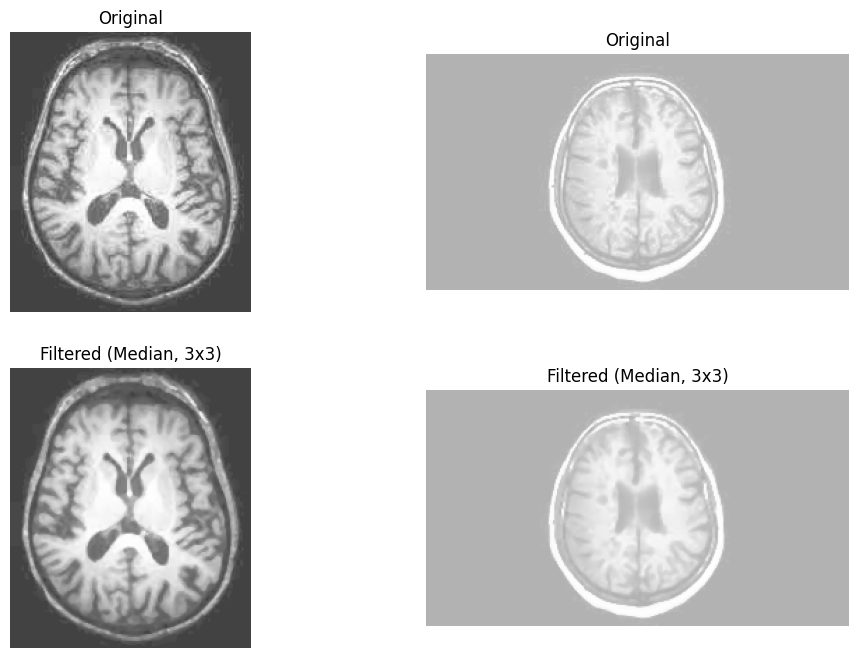

In [195]:
apply_median_filter_and_display(h_images, size=3)

###  <span style="color:orange ; font-style:italic; "> ---- > applaying  the Median_filter on sick brain images : </span>

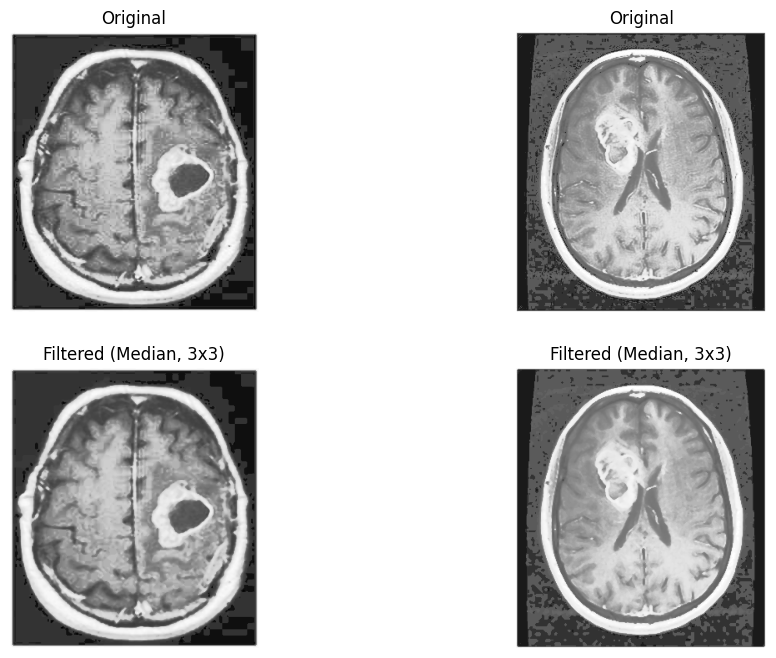

In [196]:
apply_median_filter_and_display(s_images, size=3)

## <span style="color:brown ; font-style:italic; text-decoration:underline;"> -- c ) - bilateral filter </span>

In [150]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec

def Bilateral_filter(images, d=20, sigma_color=75, sigma_space=75):
    filtered_images = []
    # Apply bilateral filter to each image
    for image in images:
        filtered_image = cv2.bilateralFilter(image, d, sigma_color, sigma_space)
        filtered_images.append(filtered_image)
    return filtered_images

def apply_bilateral_filter_and_display(images, d=20, sigma_color=75, sigma_space=75):
    filtered_images = []
    # Apply bilateral filter to each image
    for image in images:
        filtered_image = cv2.bilateralFilter(image, d, sigma_color, sigma_space)
        filtered_images.append(filtered_image)
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and filtered)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try :
        for i in range(num_images):
            row, col = divmod(i, num_cols)
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(filtered_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title("Filtered (Bilateral)")

        plt.tight_layout()
    except : pass
    plt.show()

###  <span style="color:orange ; font-style:italic; "> ---- > applaying  the bilateral filter on healthy brain images : </span>

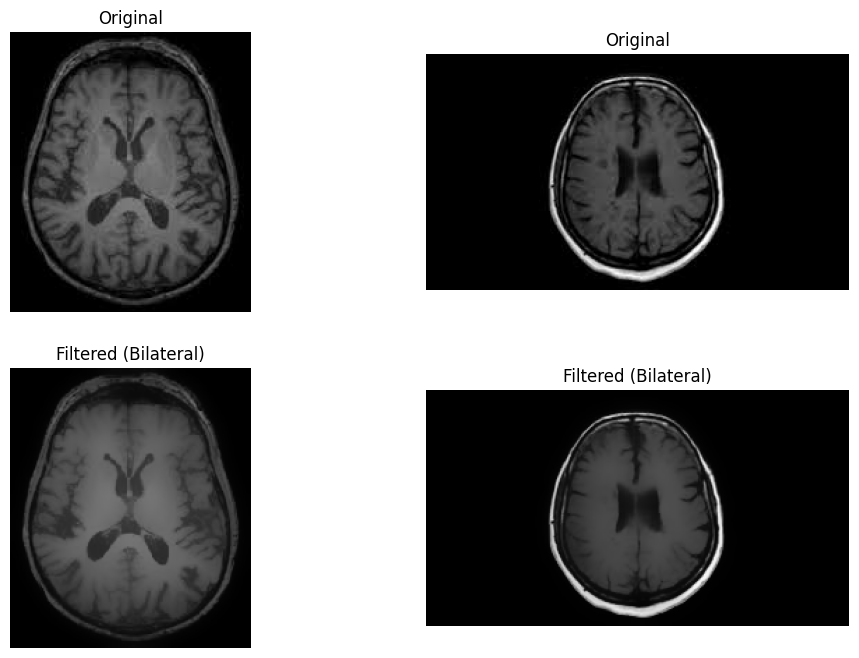

In [207]:
apply_bilateral_filter_and_display(h_images, d=20, sigma_color=75, sigma_space=75)

###  <span style="color:orange ; font-style:italic; "> ---- > applaying  the bilateral filter on sick brain images : </span>

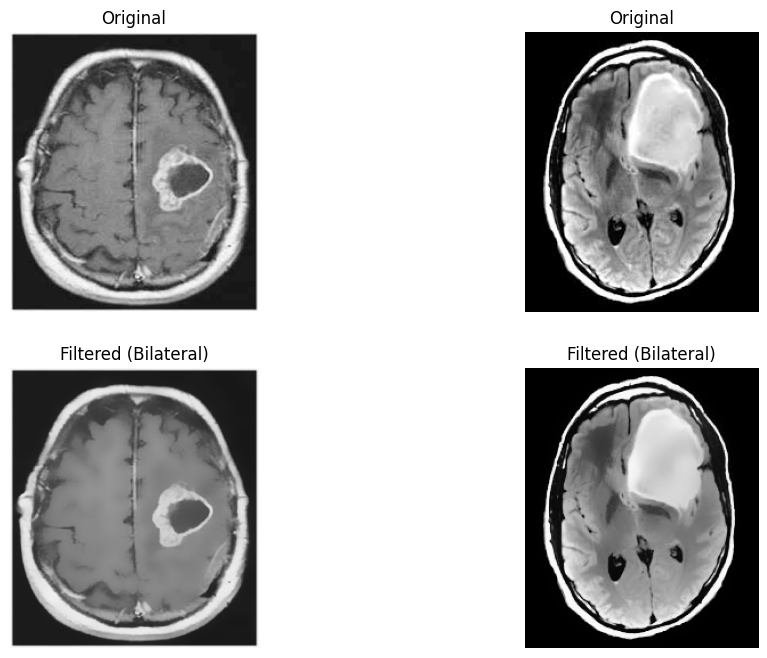

In [151]:
apply_bilateral_filter_and_display(s_images, d=20, sigma_color=75, sigma_space=75)

###  <span style="color:blue ; font-style:italic; "> ---- >It appears that only the bilateral filter has performed well on the images, so I'll continue to use it. Additionally, I plan to test each of the filters again for both edge detection and object segmentation. </span>

## <span style="color:green; font-style:italic; text-decoration:underline;"> 6) - normalize the images . </span>

In [213]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
def normalize_images(images):
    normalized_images = []
    for image in images:
        min_val = np.min(image)
        max_val = np.max(image)
        normalized_image = (image - min_val) / (max_val - min_val)
        normalized_images.append(normalized_image)
    return normalized_images

def apply_normalization_and_display(images):
    # Create a list to store the normalized images
    normalized_images = []

    # Apply normalization to each image
    for image in images:
        min_val = np.min(image)
        max_val = np.max(image)
        normalized_image = (image - min_val) / (max_val - min_val)
        normalized_images.append(normalized_image)

    # Create a grid to display images side by side
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and normalized)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try :
        for i in range(num_images):
            row, col = divmod(i, num_cols)

            # Display the original image
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")

            # Display the normalized image
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(normalized_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title("Normalized")

        plt.tight_layout()
    except: pass
    plt.show()

###  <span style="color:orange ; font-style:italic; "> ---- > normalizing  the healthy brain images : </span>

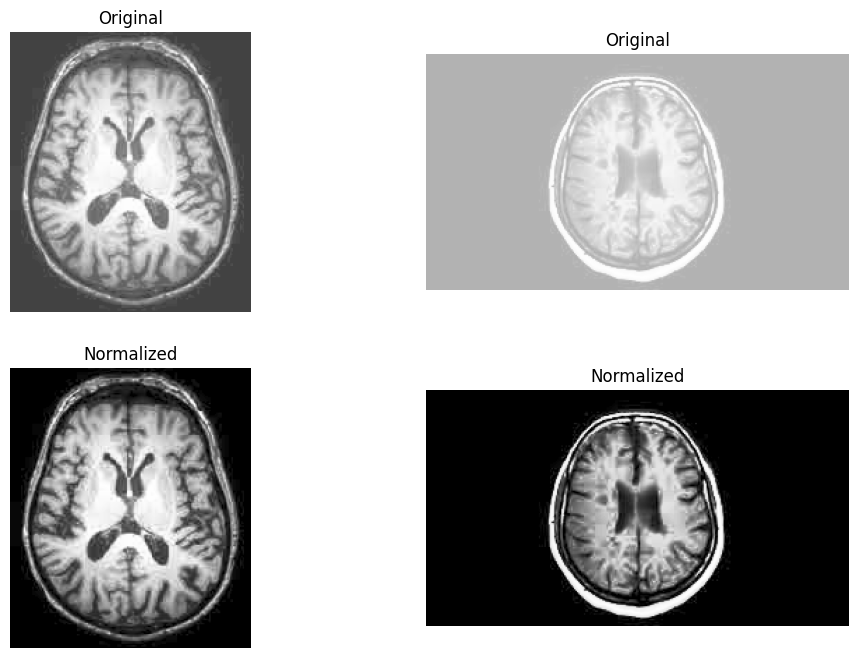

In [214]:
apply_normalization_and_display(h_images)

###  <span style="color:orange ; font-style:italic; "> ---- > normalizing  the sick brain images : </span>

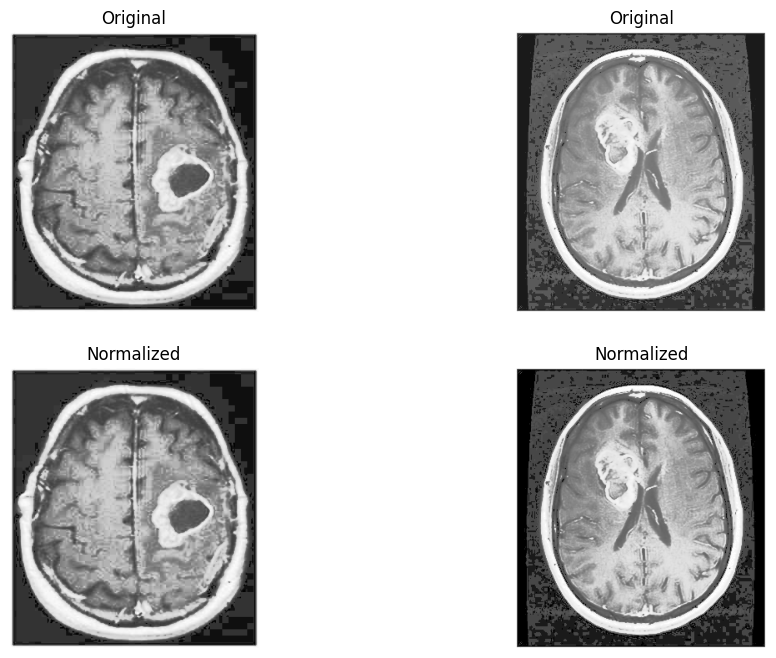

In [211]:
apply_normalization_and_display(s_images)

## <span style="color:green; font-style:italic; text-decoration:underline;"> 7) - Histogram Equalization . </span>

In [220]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
from matplotlib.gridspec import GridSpec

def apply_histogram_equalization_and_display(images):
    # Create a list to store the equalized images
    equalized_images = []

    # Apply histogram equalization to each image
    for image in images:
        equalized_image = exposure.equalize_hist(image)
        equalized_images.append(equalized_image)

    # Create a grid to display images side by side
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and equalized)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try :
        for i in range(num_images):
            row, col = divmod(i, num_cols)

            # Display the original image
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")

            # Display the equalized image
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(equalized_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title("Equalized")

        plt.tight_layout()
    except : pass
    plt.show()


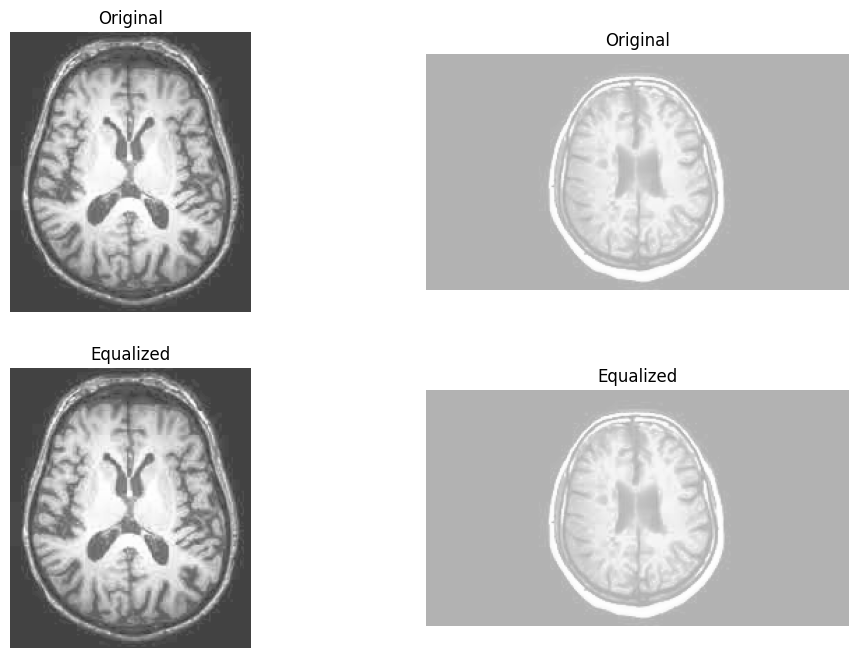

In [221]:
apply_histogram_equalization_and_display(h_images)

## <span style="color:green; font-style:italic; text-decoration:underline;"> 7) - quantization of the images . </span>

In [235]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from matplotlib.gridspec import GridSpec

def apply_quantization_and_display(images, n_colors=16):
    quantized_images = []
    for image in images:
        # Flatten the image for KMeans
        flat_image = image.reshape(-1, 3)
        kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(flat_image)
        quantized_image = kmeans.cluster_centers_[kmeans.labels_].reshape(image.shape)
        quantized_images.append(quantized_image)
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and quantized)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try  : 
        for i in range(num_images):
            row, col = divmod(i, num_cols)
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i])
            ax1.axis('off')
            ax1.set_title("Original")
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(quantized_images[i])
            ax2.axis('off')
            ax2.set_title("Quantized")

        plt.tight_layout()
    except : pass
    plt.show()

###  <span style="color:orange ; font-style:italic; "> ---- > the  quantization of   the sick brain images : </span>

C:\Users\dell\AppData\Roaming\Python\Python310\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\dell\AppData\Roaming\Python\Python310\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\dell\AppData\Roaming\Python\Python310\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


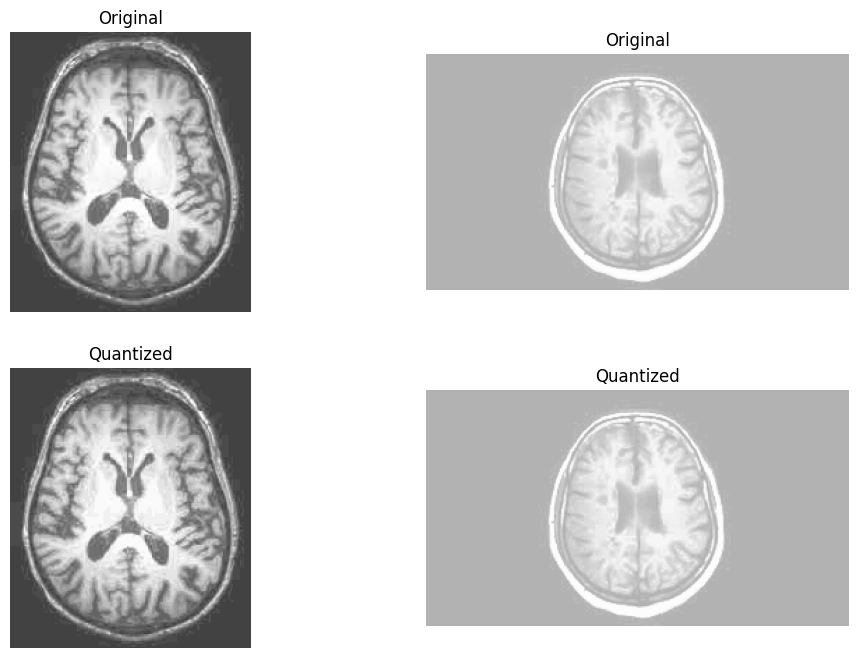

In [236]:
apply_quantization_and_display(h_images, n_colors=16)

###  <span style="color:orange ; font-style:italic; "> ---- >  the quantization  of the sick brain images : </span>

C:\Users\dell\AppData\Roaming\Python\Python310\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\dell\AppData\Roaming\Python\Python310\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\dell\AppData\Roaming\Python\Python310\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


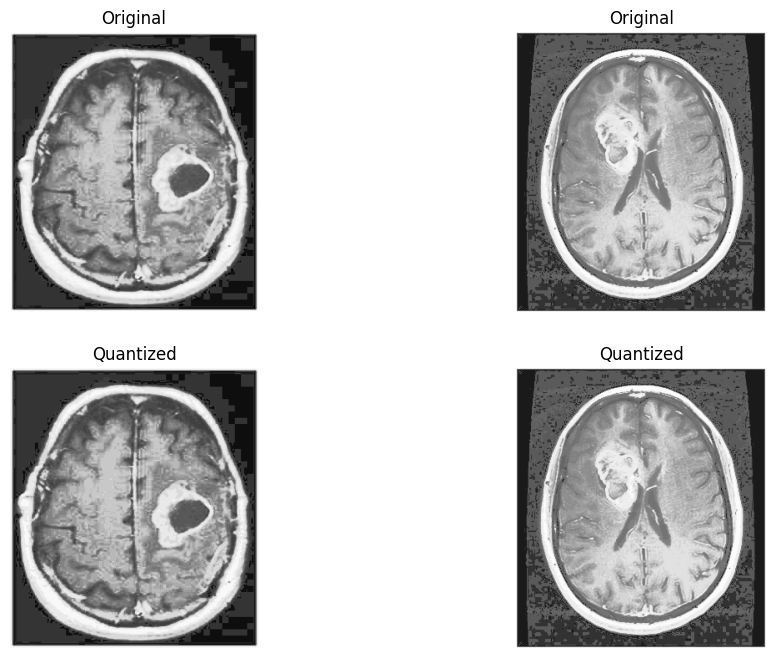

In [234]:
apply_quantization_and_display(s_images, n_colors=16)

# <span style="color:red; font-style:italic; text-decoration:underline;"> B) - Edge detection . </span>

### <span style="color:brown; font-style:italic; text-decoration:underline;"> a) - Laplacian of Gaussian (LoG) Filter</span>

In [137]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec

def apply_log_filter_and_display(images, kernel_size, sigma):
    # Create a list to store the edge-detected images
    edge_images = []

    # Apply LoG filter to each image
    for image in images:
        # Convert the image to grayscale
        grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Apply Gaussian blur to reduce noise
        blurred_image = cv2.GaussianBlur(grayscale_image, kernel_size, sigma)

        # Apply Laplacian filter (LoG)
        edge_image = cv2.Laplacian(blurred_image, cv2.CV_64F)

        edge_images.append(edge_image)

    # Create a grid to display images side by side
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and edge-detected)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try:
        for i in range(num_images):
            row, col = divmod(i, num_cols)

            # Display the original image
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")

            # Display the edge-detected image
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(edge_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title("Edge Detection")
    except: pass
    plt.tight_layout()
    plt.show()

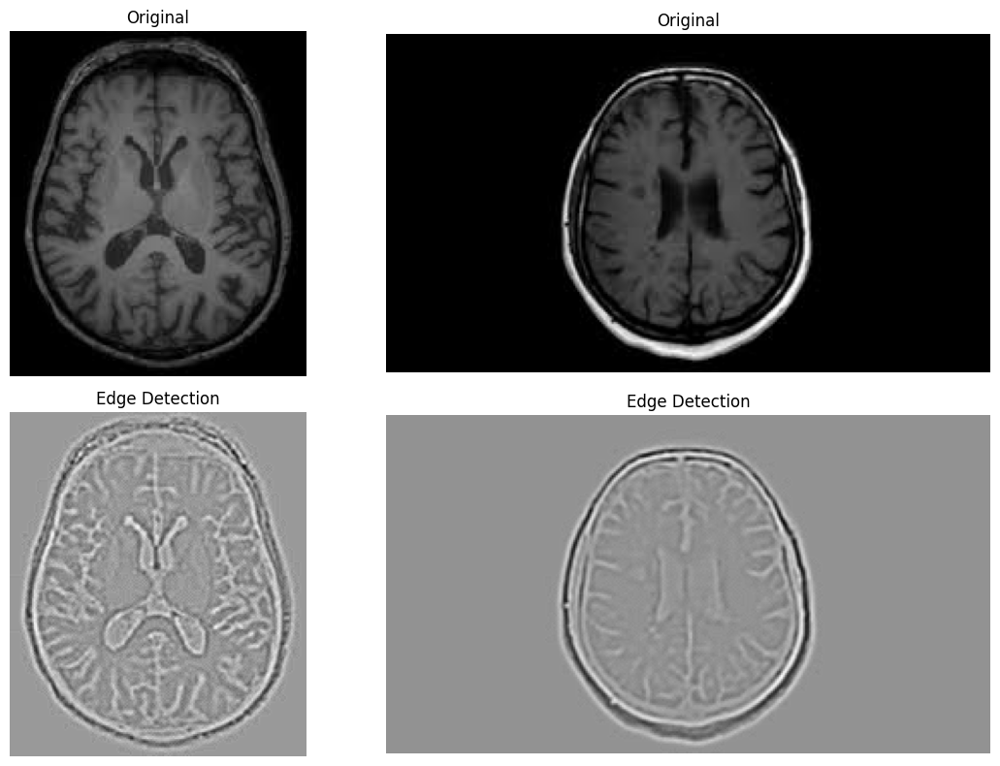

In [138]:
apply_log_filter_and_display(h_images, kernel_size=(5, 5), sigma=1)

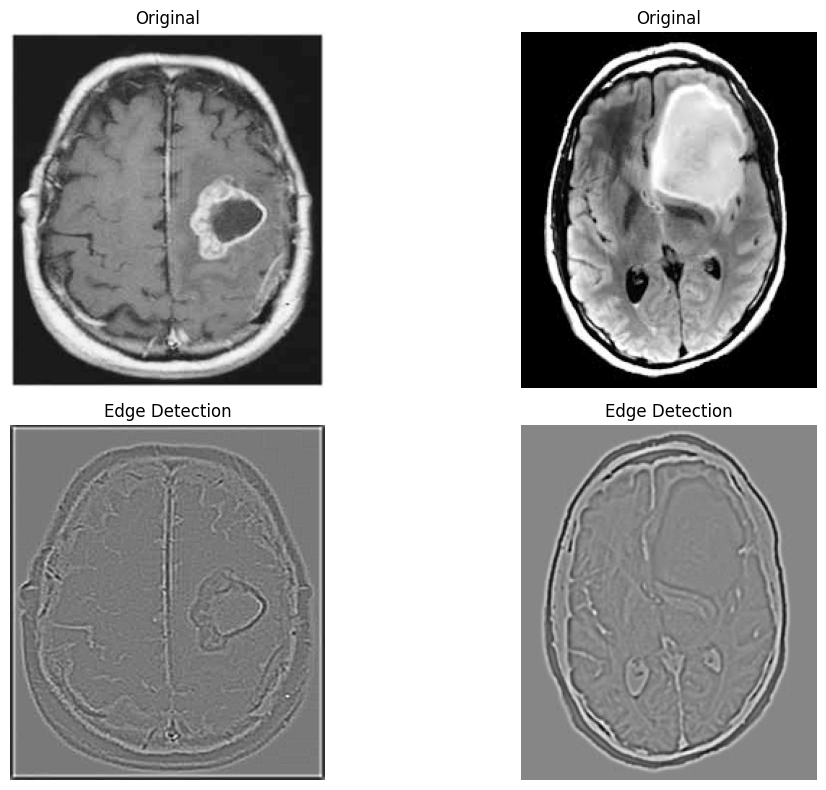

In [139]:
apply_log_filter_and_display(s_images, kernel_size=(5, 5), sigma=1)

### <span style="color:brown; font-style:italic; text-decoration:underline;"> b) - The  Sobel Operator </span>

### <span style="color:blue; font-style:italic; text-decoration:underline;"> The Sobel operator is a widely used image processing technique for edge detection. It is named after its inventors, Irwin Sobel and Gary Feldman, and is used to find the approximate absolute gradient of the image intensity at each pixel. </span>

In [141]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import convolve2d
from matplotlib.gridspec import GridSpec

def apply_prewitt_operator_and_display(images):
    # Create a list to store the edge-detected images
    edge_images = []

    # Apply the Prewitt operator to each image
    prewitt_x = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])
    prewitt_y = np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]])

    for image in images:
        grayscale_image = image.mean(axis=2)  # Convert to grayscale
        gradient_x = convolve2d(grayscale_image, prewitt_x, mode='same', boundary='symm')
        gradient_y = convolve2d(grayscale_image, prewitt_y, mode='same', boundary='symm')
        edge_image = np.sqrt(gradient_x**2 + gradient_y**2)
        edge_images.append(edge_image)

    # Create a grid to display images side by side
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and edge-detected)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try:
        for i in range(num_images):
            row, col = divmod(i, num_cols)

            # Display the original image
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")

            # Display the edge-detected image
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(edge_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title("Edge Detection")
    except: pass
    plt.tight_layout()
    plt.show()


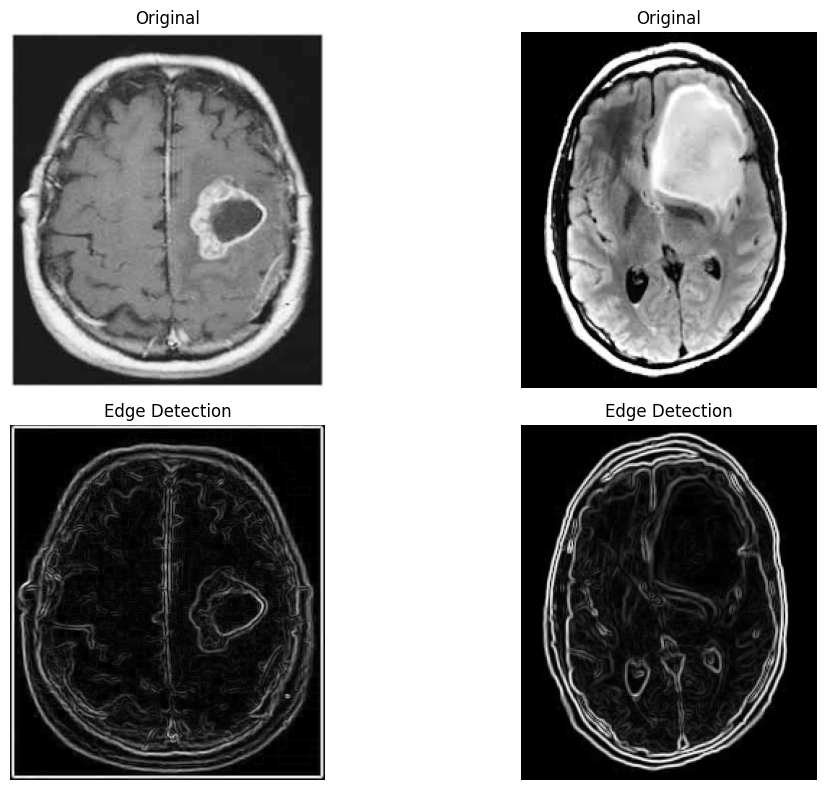

In [142]:
apply_prewitt_operator_and_display(s_images)


### <span style="color:brown; font-style:italic; text-decoration:underline;"> c) - morphological_edge_detection</span>

In [143]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from matplotlib.gridspec import GridSpec

def morphological_edge_detection_and_display(images, kernel_size):
    # Create a list to store the edge detection results
    edge_images = []

    # Define a structuring element (kernel)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (kernel_size, kernel_size))

    # Apply morphological edge detection to each image
    for image in images:
        # Convert the image to grayscale
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        
        # Apply morphological gradient to find edges
        gradient_image = cv2.morphologyEx(gray_image, cv2.MORPH_GRADIENT, kernel)
        
        # Convert the result back to color for display
        edge_image = cv2.cvtColor(gradient_image, cv2.COLOR_GRAY2BGR)
        
        edge_images.append(edge_image)

    # Create a grid to display images side by side
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and edge detection)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try:
        for i in range(num_images):
            row, col = divmod(i, num_cols)

            # Display the original image
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")

            # Display the edge-detected image
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(edge_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title("Edge Detection")
    except: pass
    plt.tight_layout()
    plt.show()


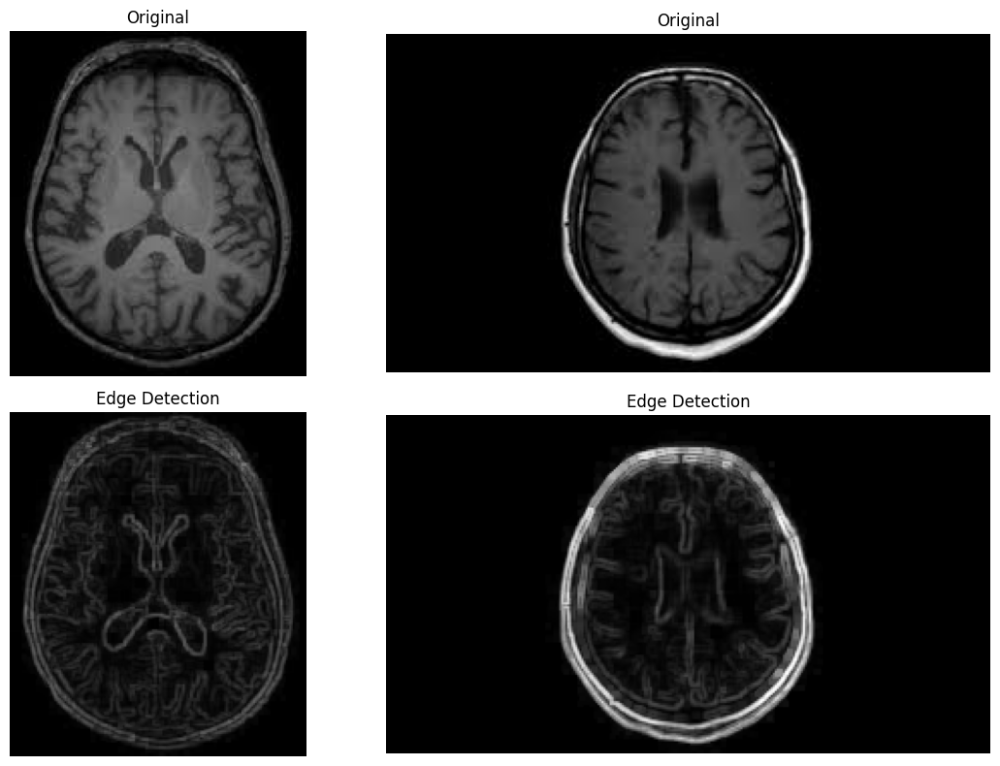

In [144]:
morphological_edge_detection_and_display(h_images, kernel_size=3)

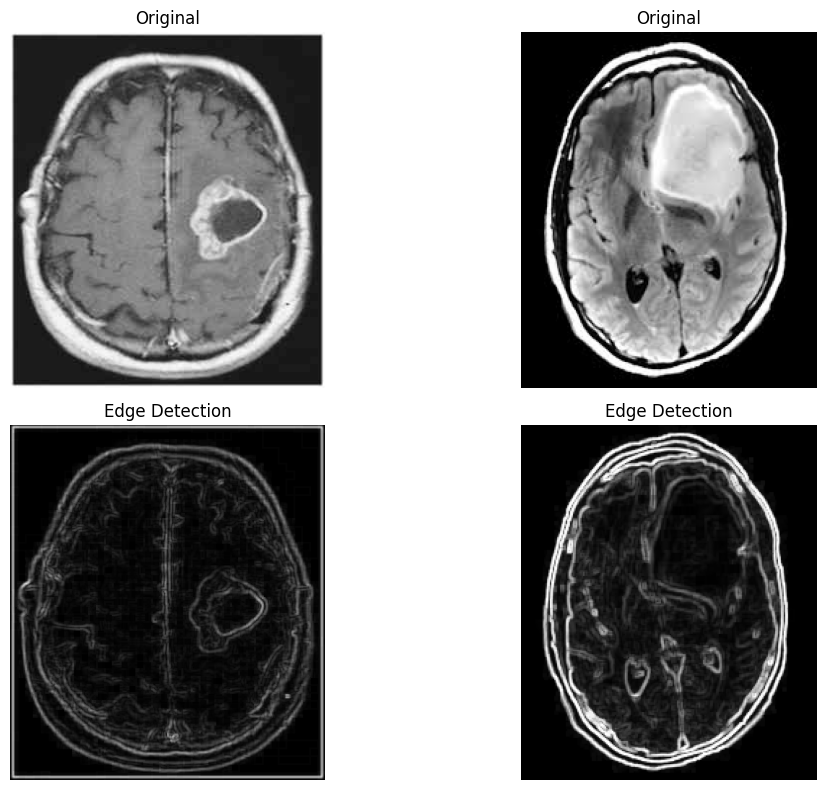

In [145]:
morphological_edge_detection_and_display(s_images, kernel_size=3)

### <span style="color:brown; font-style:italic; text-decoration:underline;"> c) - Canny edge detection</span>

In [146]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec

def edge_detection_and_display(images, threshold1=100, threshold2=200):
    # Create a list to store the edge-detected images
    edge_images = []

    for image in images:
        # Apply Canny edge detection
        edges = cv2.Canny(image, threshold1, threshold2)
        edge_images.append(edges)

    # Create a grid to display images side by side
    num_images = len(images)
    num_cols = 2  # 2 columns for each image (original and edge-detected)
    num_rows = (num_images + 1) // num_cols  # Calculate the number of rows

    fig = plt.figure(figsize=(12, 8))
    gs = GridSpec(num_rows, num_cols)
    try:
        for i in range(num_images):
            row, col = divmod(i, num_cols)

            # Display the original image
            ax1 = fig.add_subplot(gs[row * 2, col])
            ax1.imshow(images[i], cmap='gray')
            ax1.axis('off')
            ax1.set_title("Original")

            # Display the edge-detected image
            ax2 = fig.add_subplot(gs[row * 2 + 1, col])
            ax2.imshow(edge_images[i], cmap='gray')
            ax2.axis('off')
            ax2.set_title("Edge Detection")
    except: pass

    plt.tight_layout()
    plt.show()

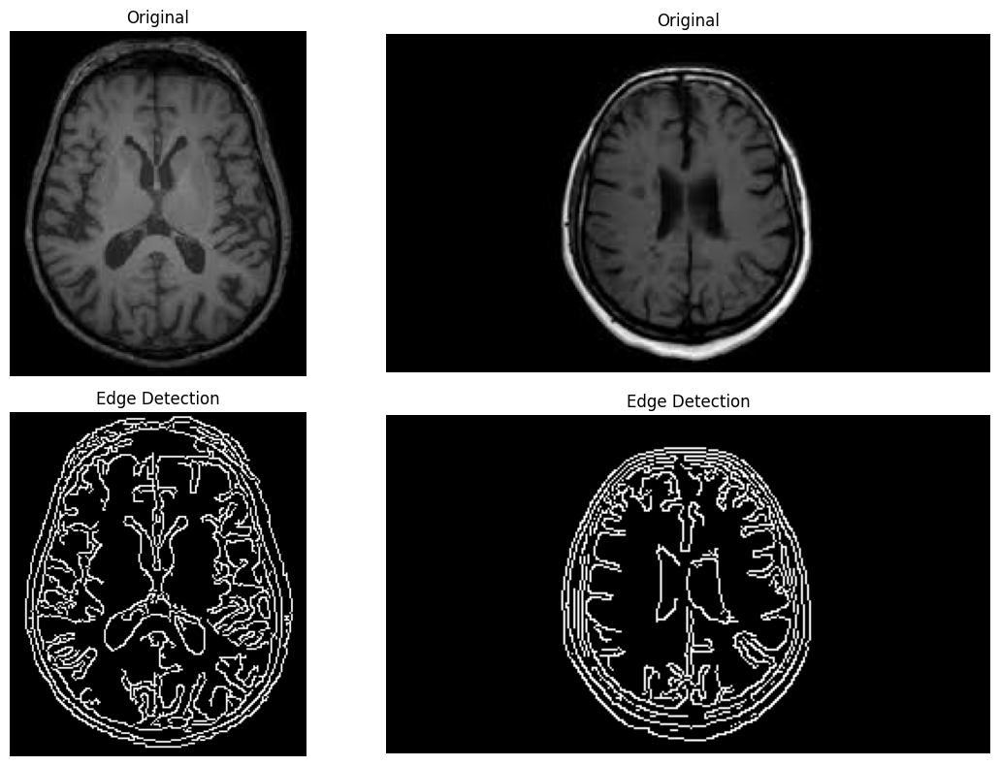

In [13]:
edge_detection_and_display(h_images, threshold1=50, threshold2=200)


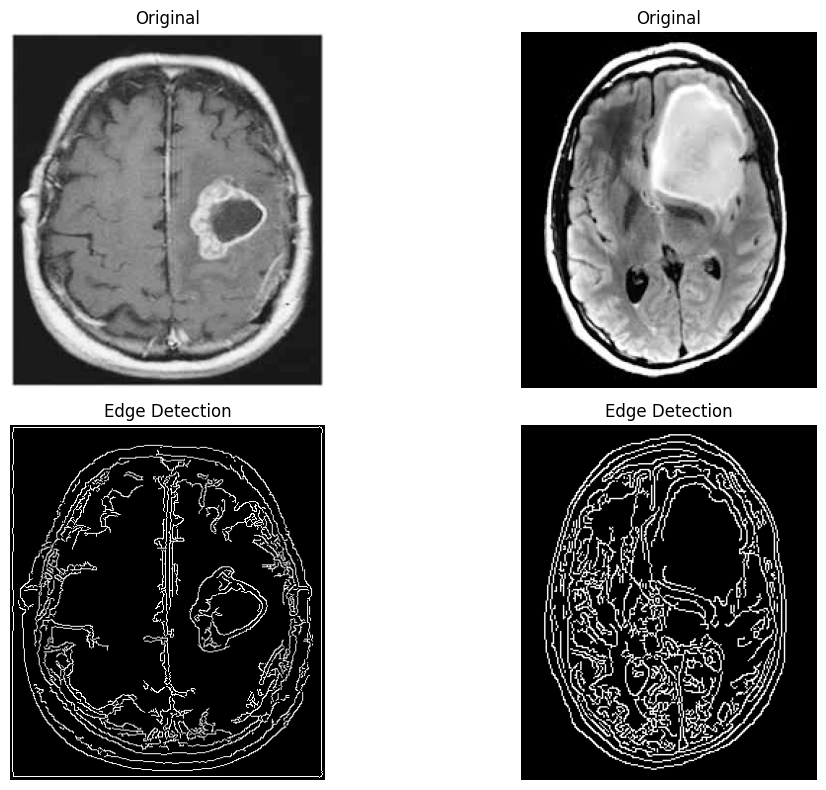

In [147]:
edge_detection_and_display(s_images, threshold1=50, threshold2=200)


###  <span style="color:blue ; font-style:italic; ">It seems that Canny edge detection has shown the best result so far</span>

# <span style="color:red; font-style:italic; text-decoration:underline;"> c) - Image Segmentation. </span>

Text(0.5, 0.98, 'Original & RGB image channels')

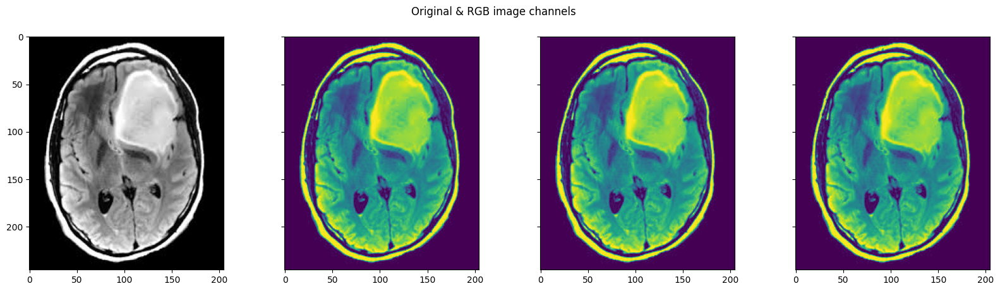

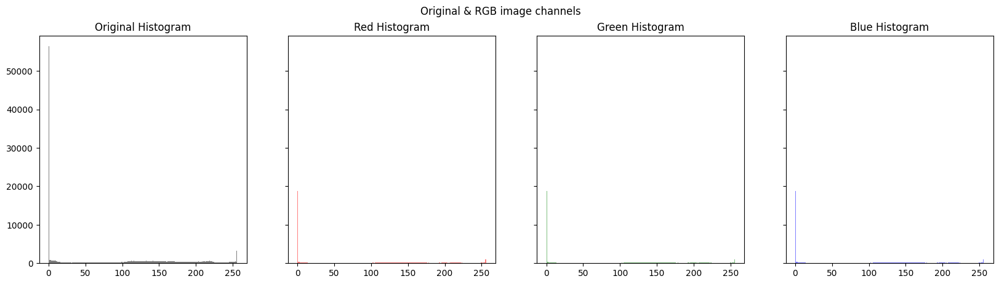

In [10]:
# plotting the original image and the RGB channels 
image = io.imread(sick_br_path +'/'+ sick_br_images [6])  
i, (im1, im2, im3, im4) = plt.subplots(1, 4, sharey=True)
i.set_figwidth(20) 
im1.imshow(image)  #Original image
im2.imshow(image[:, : , 0]) #Red
im3.imshow(image[:, : , 1]) #Green
im4.imshow(image[:, : , 2]) #Blue
i.suptitle('Original & RGB image channels')
# plotting the original image and the RGB channels 
image = io.imread(sick_br_path +'/'+ sick_br_images [6])  
i, (hist1, hist2, hist3, hist4) = plt.subplots(1, 4, sharey=True)
i.set_figwidth(20) 
# Histograms
hist1.hist(image.ravel(), bins=256, range=(0, 256), color='k', alpha=0.5)
hist1.set_title('Original Histogram')

hist2.hist(image[:, :, 0].ravel(), bins=256, range=(0, 256), color='r', alpha=0.5)
hist2.set_title('Red Histogram')

hist3.hist(image[:, :, 1].ravel(), bins=256, range=(0, 256), color='g', alpha=0.5)
hist3.set_title('Green Histogram')
hist3.set_facecolor('w')  # Set white background for the green histogram

hist4.hist(image[:, :, 2].ravel(), bins=256, range=(0, 256), color='b', alpha=0.5)
hist4.set_title('Blue Histogram')
i.suptitle('Original & RGB image channels')

## <span style="color:green; font-style:italic; text-decoration:underline;"> 1) - threshold_adaptive_adaptative_segmantation </span>

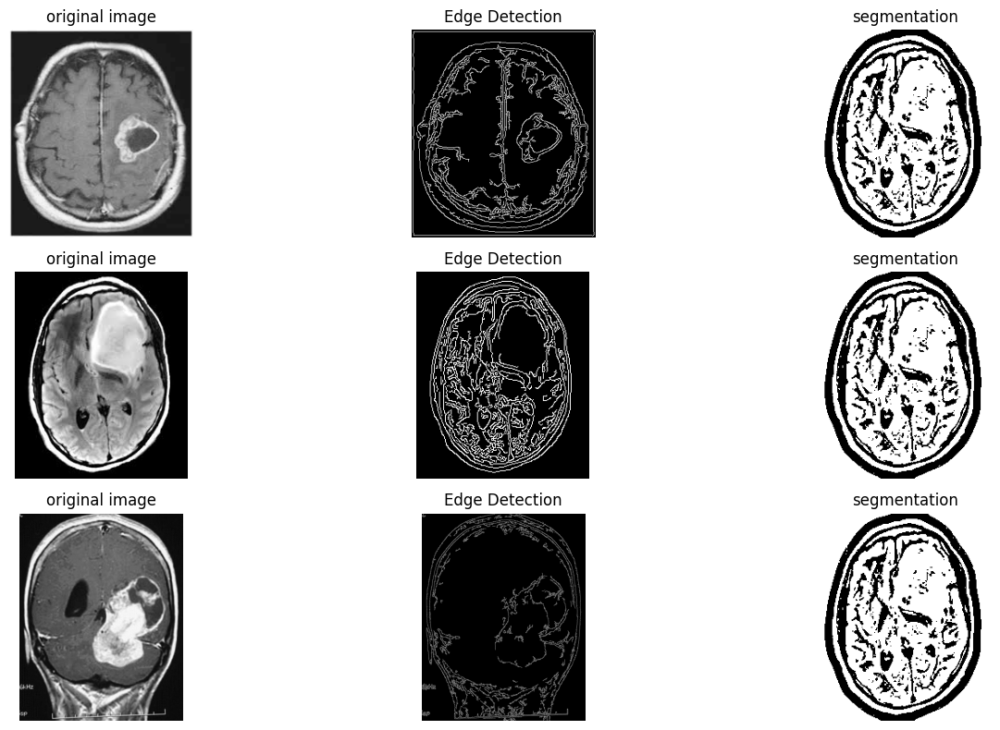

In [148]:

import matplotlib.pyplot as plt
from skimage.filters import threshold_local
from skimage import io, color

images =s_images
def  display_segmentation_results(images , images_res ):
    images_edges = [ cv2.Canny(im, threshold1=50, threshold2=200) for im in images ]
    num_images = len(images)
    num_columns = 3
    fig, axes = plt.subplots(num_images, num_columns, figsize=(15, 8))
    for i in range(num_images):
        axes[i , 0].imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
        axes[i , 0].set_title("original image")
        axes[i , 0].axis('off')
        axes[i , 1].imshow(images_edges[i], cmap='gray')
        axes[i , 1].set_title("Edge Detection")
        axes[i , 1].axis('off')
        axes[i , 2].imshow(images_res[i], cmap='gray')
        axes[i , 2].set_title('segmentation')
        axes[i , 2].axis('off')
    plt.tight_layout()
    plt.show()

def  threshold_adaptive_adaptative_segmantation(image , block_size= 35 , offset = 10 ):
    image = io.imread(sick_br_path +'/'+ sick_br_images [6])
    if image.shape[-1] == 3:
        image = color.rgb2gray(image)
    image = (image * 255).astype('uint8')
    threshold_adaptive = threshold_local(image, block_size, offset=offset)
    image_binarized_adaptive = image > threshold_adaptive
    return image_binarized_adaptive  
def threshold_adaptive_adaptative_segmantation_on_list_images(images ):
    return [ threshold_adaptive_adaptative_segmantation(im , block_size= 35 , offset = 10 ) for im in images ]
display_segmentation_results(images , threshold_adaptive_adaptative_segmantation_on_list_images(s_images ))

## <span style="color:green; font-style:italic; text-decoration:underline;"> 2) - Otsu_Thresholding segmentation </span>

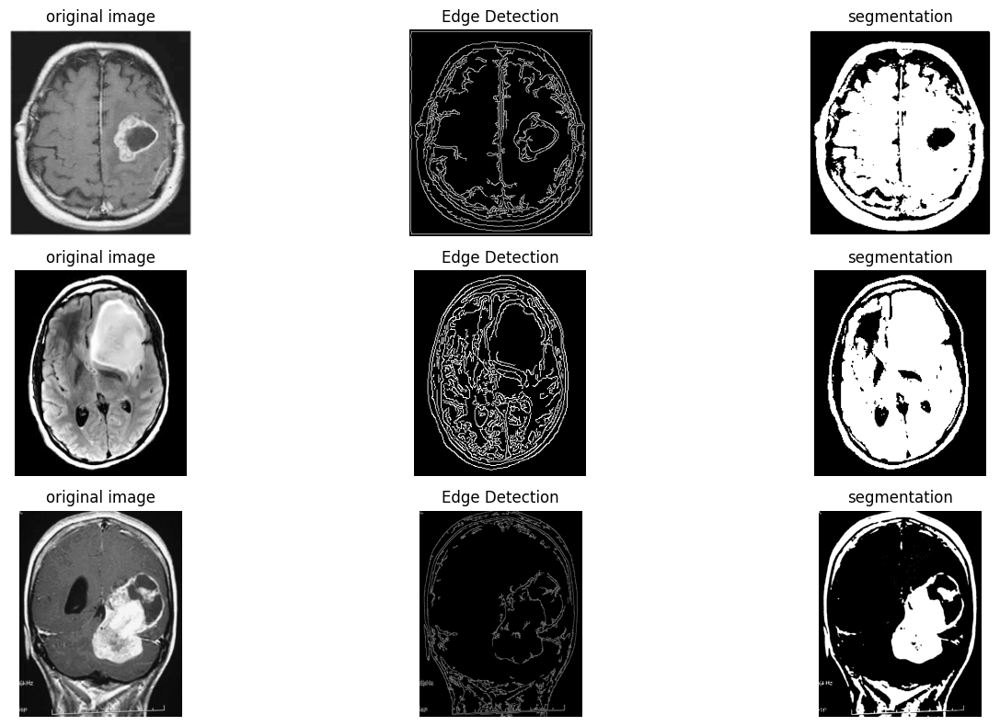

In [149]:
from skimage import color, io
from skimage.filters import threshold_otsu

# Define the Otsu thresholding segmentation function
def Otsu_Thresholding_segmentation(image):
    if image.shape[-1] == 3:
        image = color.rgb2gray(image)
    threshold_otsu_value = threshold_otsu(image)
    image_binarized_otsu = image > threshold_otsu_value
    return image_binarized_otsu
def Otsu_Thresholding_segmantation_on_list_images(images):
    return [Otsu_Thresholding_segmentation(im) for im in images]
display_segmentation_results(images, Otsu_Thresholding_segmantation_on_list_images(images))


## <span style="color:green; font-style:italic; text-decoration:underline;"> 3) -  region_growing segmentation </span>

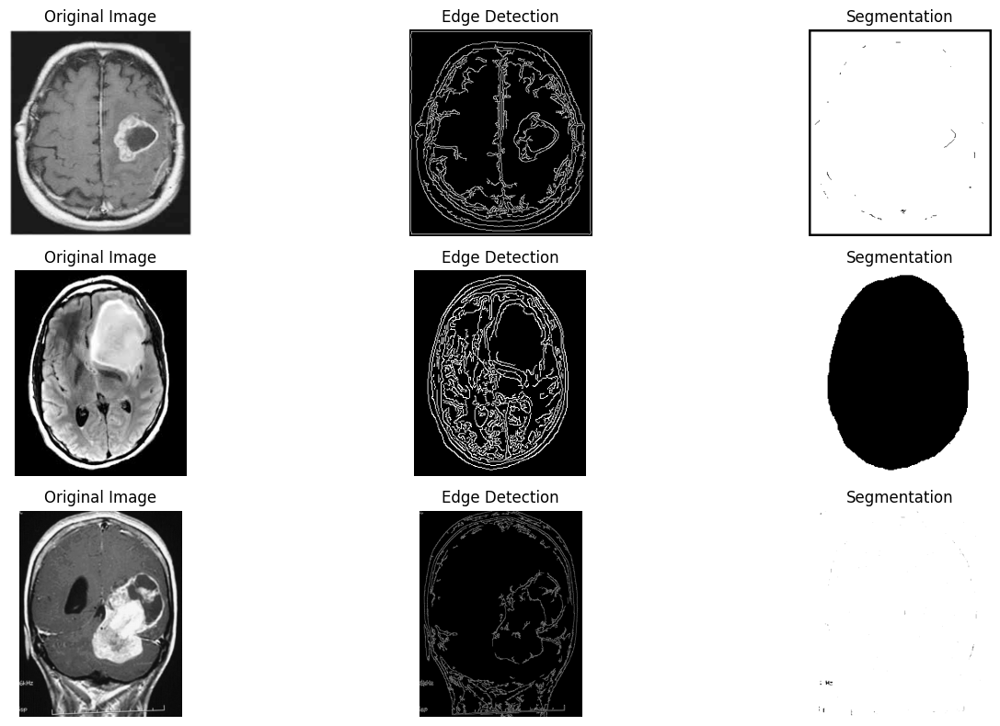

In [156]:
import numpy as np
import matplotlib.pyplot as plt

import cv2
import numpy as np
import matplotlib.pyplot as plt

# Define a function to display results for a list of images, edge detection, and segmentation results
def display_results(images, images_res):
    num_images = len(images)
    num_columns = 3
    fig, axes = plt.subplots(num_images, num_columns, figsize=(15, 8))

    for i in range(num_images):
        # Display the original image
        axes[i, 0].imshow(images[i], cmap='gray')
        axes[i, 0].set_title("Original Image")
        axes[i, 0].axis('off')

        # Perform edge detection (you can customize the parameters)
        edges = cv2.Canny(images[i], threshold1=50, threshold2=200)
        axes[i, 1].imshow(edges, cmap='gray')
        axes[i, 1].set_title("Edge Detection")
        axes[i, 1].axis('off')

        # Display the segmentation result (assuming images_res is a list of segmented images)
        segmented_image = images_res[i]
        axes[i, 2].imshow(segmented_image, cmap='gray')
        axes[i, 2].set_title('Segmentation')
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()

def region_growing(image, seed, intensity_threshold):
    if len(image.shape) == 3 :
        image= image[:,:,1]
    height, width = image.shape
    visited = np.zeros_like(image, dtype=bool)
    segmented = np.zeros_like(image, dtype=bool)
    list_pixels = [seed]

    while list_pixels:
        current_pixel = list_pixels.pop()
        x, y = current_pixel

        if visited[y, x]:
            continue

        visited[y, x] = True
        segmented[y, x] = True

        for dx in [-1, 0, 1]:
            for dy in [-1, 0, 1]:
                nx, ny = x + dx, y + dy
                if 0 <= nx < width and 0 <= ny < height:
                    difference = abs(int(image[y, x]) - int(image[ny, nx]))
                    if not visited[ny, nx] and difference < intensity_threshold:
                        list_pixels.append((nx, ny))
    return segmented
intensity_threshold = 20  # Adjust according to the image
seed_point = (20, 20)  # Choose according to the image


def region_growing_list_images(images, seed_point , intensity_threshold):
    return [region_growing(im, seed_point, intensity_threshold) for im in images ]

segmented_image = region_growing_list_images(s_images, seed_point, intensity_threshold)
display_results(s_images, segmented_image)

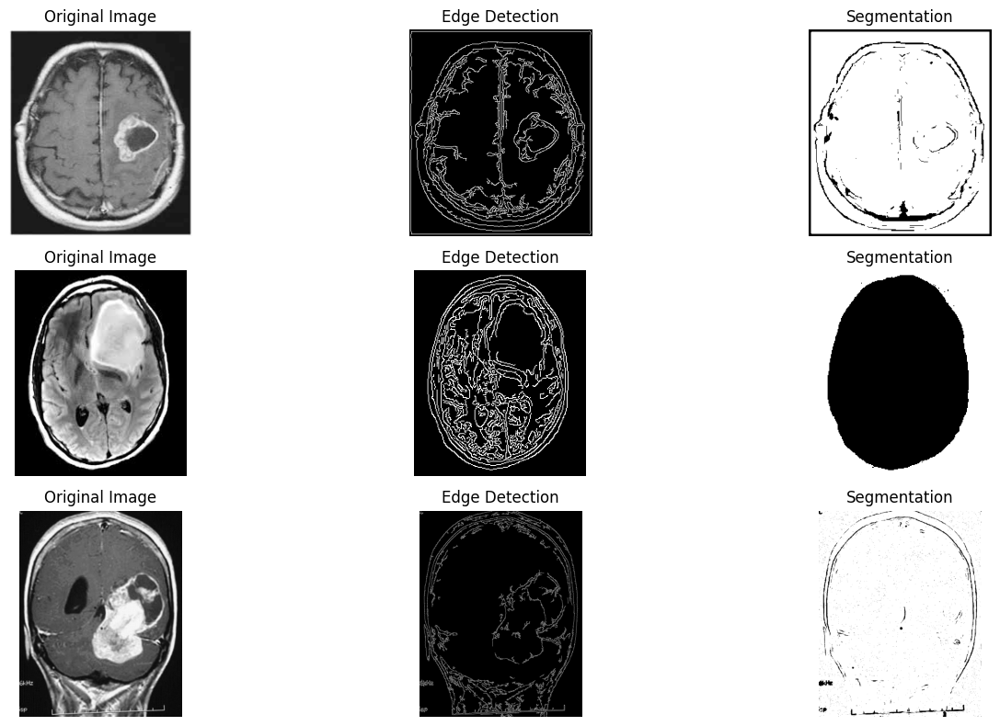

In [157]:
import numpy as np
import matplotlib.pyplot as plt

import cv2
import numpy as np
import matplotlib.pyplot as plt

# Define a function to display results for a list of images, edge detection, and segmentation results
def display_results(images, images_res):
    num_images = len(images)
    num_columns = 3
    fig, axes = plt.subplots(num_images, num_columns, figsize=(15, 8))

    for i in range(num_images):
        # Display the original image
        axes[i, 0].imshow(images[i], cmap='gray')
        axes[i, 0].set_title("Original Image")
        axes[i, 0].axis('off')

        # Perform edge detection (you can customize the parameters)
        edges = cv2.Canny(images[i], threshold1=50, threshold2=200)
        axes[i, 1].imshow(edges, cmap='gray')
        axes[i, 1].set_title("Edge Detection")
        axes[i, 1].axis('off')

        # Display the segmentation result (assuming images_res is a list of segmented images)
        segmented_image = images_res[i]
        axes[i, 2].imshow(segmented_image, cmap='gray')
        axes[i, 2].set_title('Segmentation')
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()

def region_growing(image, seed, intensity_threshold):
    if len(image.shape) == 3 :
        image= image[:,:,1]
    height, width = image.shape
    visited = np.zeros_like(image, dtype=bool)
    segmented = np.zeros_like(image, dtype=bool)
    list_pixels = [seed]

    while list_pixels:
        current_pixel = list_pixels.pop()
        x, y = current_pixel

        if visited[y, x]:
            continue

        visited[y, x] = True
        segmented[y, x] = True

        for dx in [-1, 0, 1]:
            for dy in [-1, 0, 1]:
                nx, ny = x + dx, y + dy
                if 0 <= nx < width and 0 <= ny < height:
                    difference = abs(int(image[y, x]) - int(image[ny, nx]))
                    if not visited[ny, nx] and difference < intensity_threshold:
                        list_pixels.append((nx, ny))
    return segmented
intensity_threshold = 11  # Adjust according to the image
seed_point = (20, 20)  # Choose according to the image


def region_growing_list_images(images, seed_point , intensity_threshold):
    return [region_growing(im, seed_point, intensity_threshold) for im in images ]

segmented_image = region_growing_list_images(s_images, seed_point, intensity_threshold)
display_results(s_images, segmented_image)

## <span style="color:green; font-style:italic; text-decoration:underline;"> 4) -   k-Means Clustering_Segmentation</span>

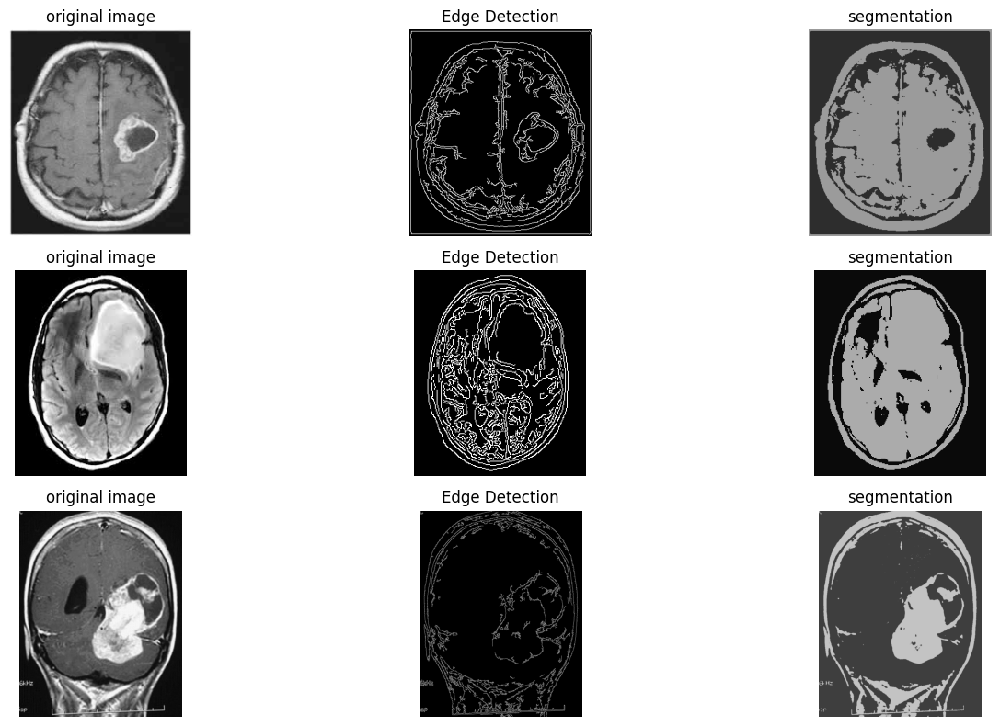

In [164]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import data
from sklearn.cluster import KMeans

# Load the camera image
image = s_images[0]
def Clustering_Segmentation_kMeans(image ,k = 2  , init_method = 'k-means++' ,max_iter = 300 ,n_init = 10 ):
    # Reshape the image into a list of pixels
    image_reshaped = image.reshape((-1, 1))  # Convert to a single channel
    kmeans = KMeans(n_clusters=k, init=init_method, max_iter=max_iter, n_init=n_init)
    kmeans.fit(image_reshaped)
    clustered = kmeans.cluster_centers_[kmeans.labels_]
    return clustered.reshape(image.shape).astype(np.uint8)

def Clustering_Segmentation_kMeans_list_images(images ,k = 2  , init_method = 'k-means++' ,max_iter = 300 ,n_init = 10 ):
    return [Clustering_Segmentation_kMeans(im ,k = 2  , init_method = 'k-means++' ,max_iter = 300 ,n_init = 10 ) for im  in images  ]
k = 2  # Number of clusters, adjust as needed
init_method = 'k-means++'  # Initialization method ('k-means++' or 'random')
max_iter = 300  # Maximum number of iterations for each run
n_init = 10  # Number of times the algorithm will be run with different centroid seeds

display_segmentation_results(s_images,Clustering_Segmentation_kMeans_list_images(s_images ,k = 2  , init_method = 'k-means++' ,max_iter = 300 ,n_init = 10 ))

## <span style="color:green; font-style:italic; text-decoration:underline;"> 5) -   segment_by_color_hsv </span>

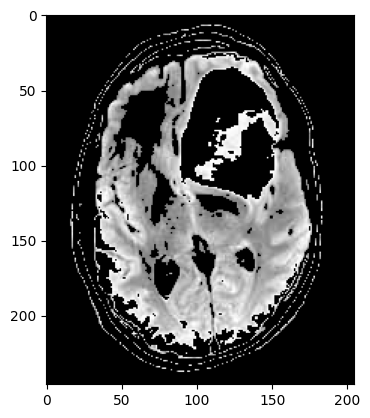

In [186]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the camera image
original_image = s_images[1][:, :, 1]

# Function to segment an image based on the HSV color
def segment_by_color_hsv(image, lower_bound, upper_bound):
    # Convert the image to BGR HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)

    # Apply a mask based on the specified color bounds
    mask = cv2.inRange(hsv_image, lower_bound, upper_bound)

    # Use the mask to extract the region of interest from the original image
    segmented_image = cv2.bitwise_and(image, image, mask=mask)

    return segmented_image

# Define the color bounds for green hue
lower = np.array([100, 10, 10])  # Adjust for specific green color range
upper = np.array([200, 200, 200])  # Adjust for specific green color range

# Segment the original image using the bounds
segmented_image = segment_by_color_hsv(original_image, lower, upper)

# Display the segmented image
plt.imshow(segmented_image, cmap='gray')
plt.show()


### <span style="color:blue; font-style:italic;"> we need to find the best combination of lower and upper numpy arrays. To do this, you can define a range for both lower and upper arrays and systematically evaluate the results for different combinations</span>

[1 1 1] [26 26 26]


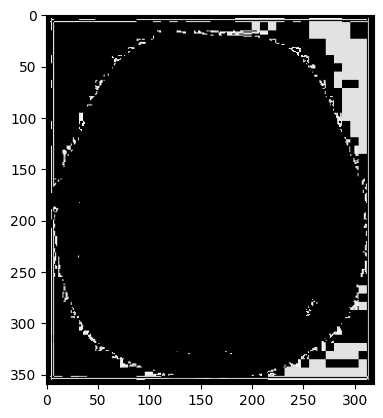

[1 1 1] [51 51 51]


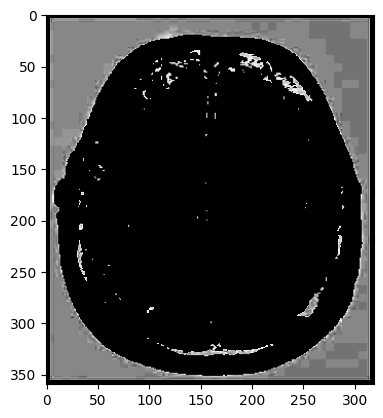

[1 1 1] [76 76 76]


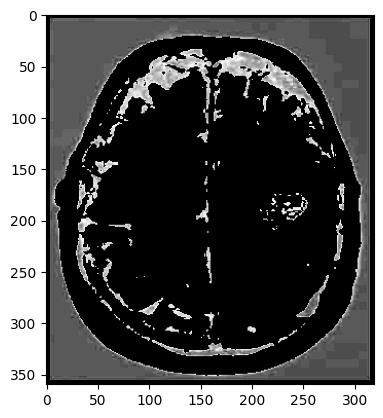

[1 1 1] [101 101 101]


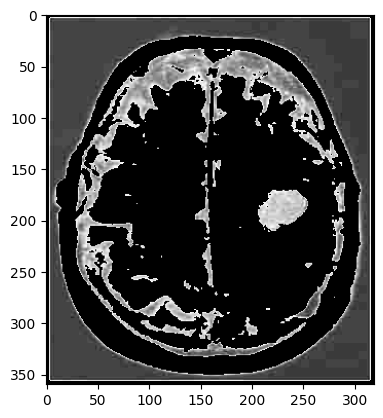

[1 1 1] [126 126 126]


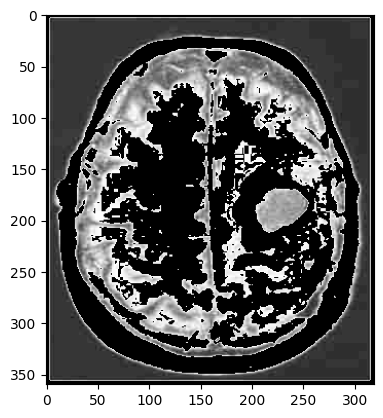

[1 1 1] [151 151 151]


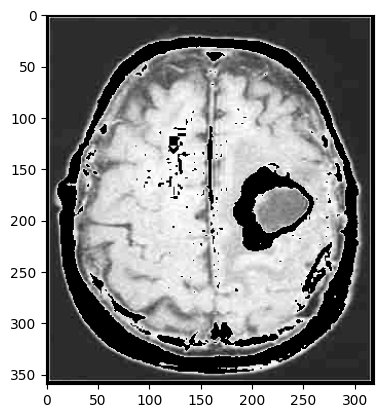

[1 1 1] [176 176 176]


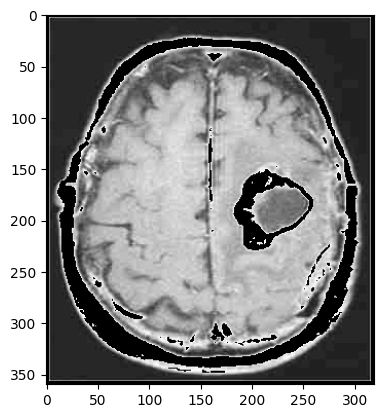

[1 1 1] [201 201 201]


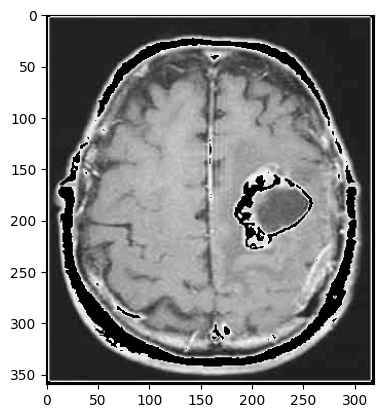

[1 1 1] [226 226 226]


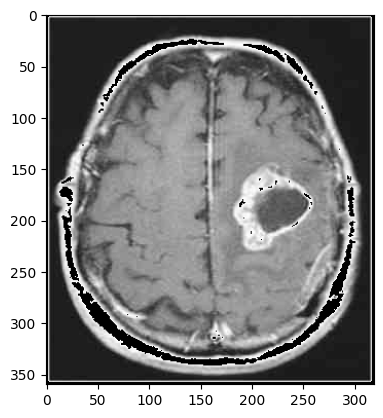

[1 1 1] [251 251 251]


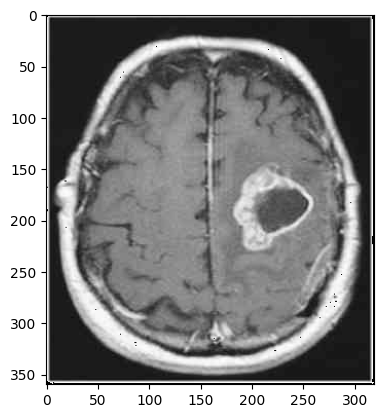

[26 26 26] [51 51 51]


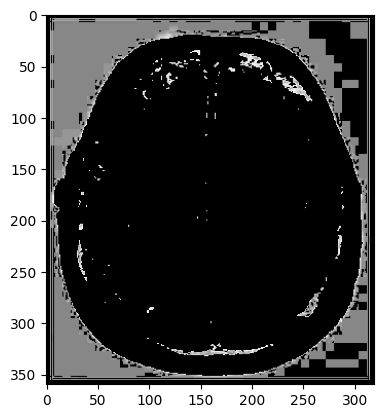

[26 26 26] [76 76 76]


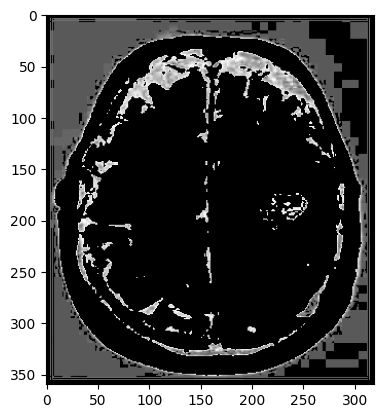

[26 26 26] [101 101 101]


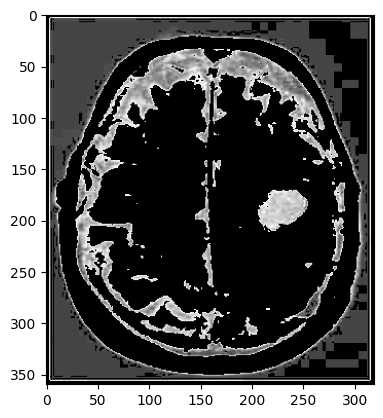

[26 26 26] [126 126 126]


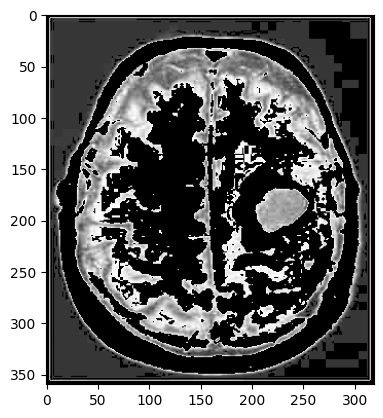

[26 26 26] [151 151 151]


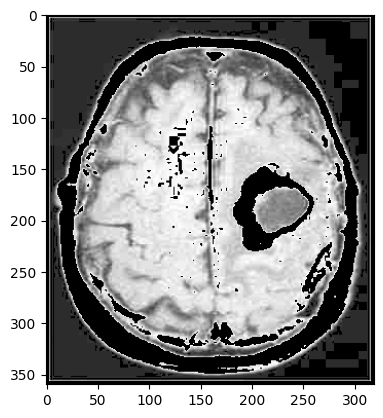

[26 26 26] [176 176 176]


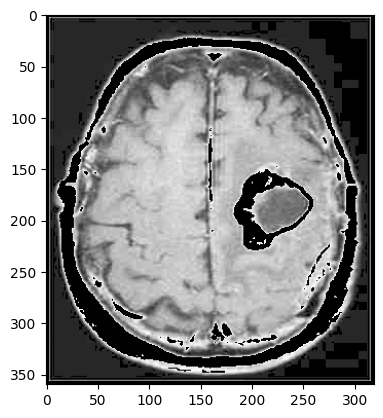

[26 26 26] [201 201 201]


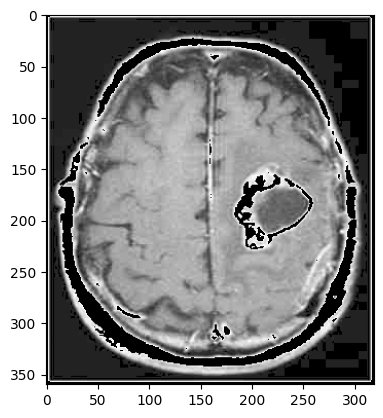

[26 26 26] [226 226 226]


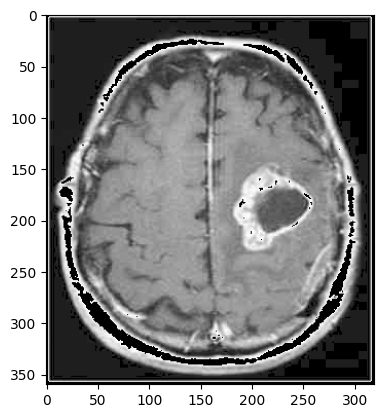

[26 26 26] [251 251 251]


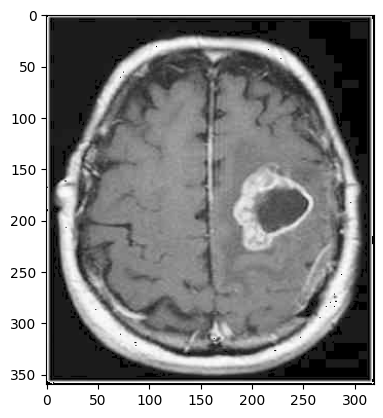

[51 51 51] [76 76 76]


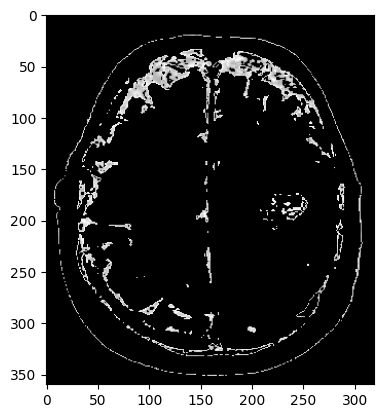

[51 51 51] [101 101 101]


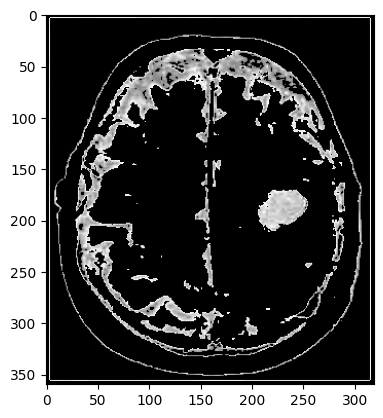

[51 51 51] [126 126 126]


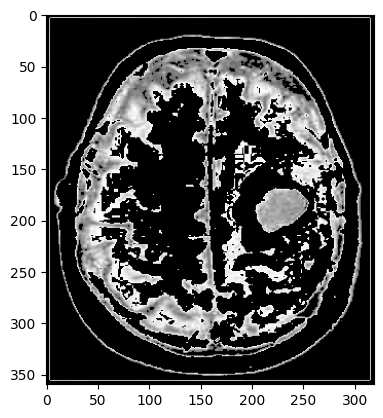

[51 51 51] [151 151 151]


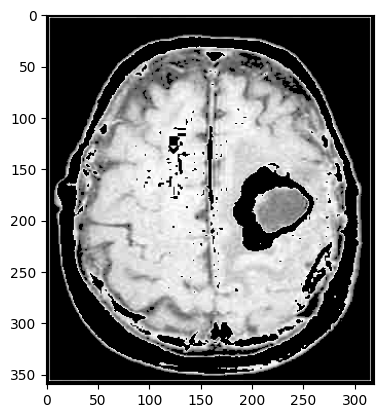

[51 51 51] [176 176 176]


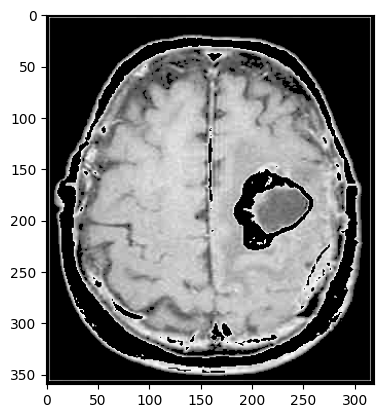

[51 51 51] [201 201 201]


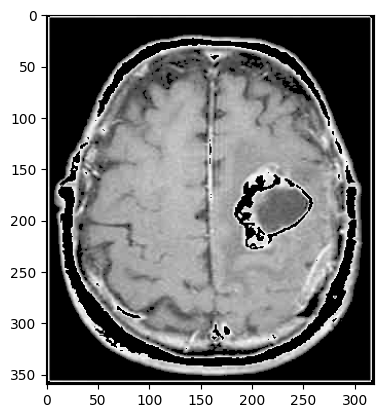

[51 51 51] [226 226 226]


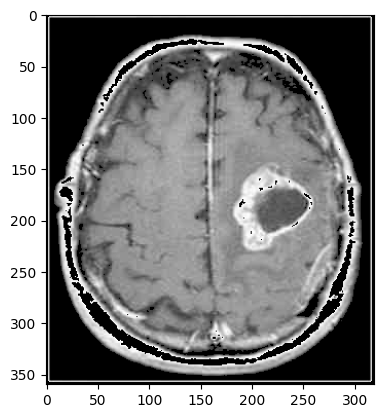

[51 51 51] [251 251 251]


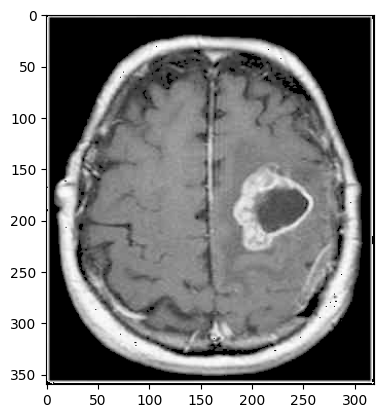

[76 76 76] [101 101 101]


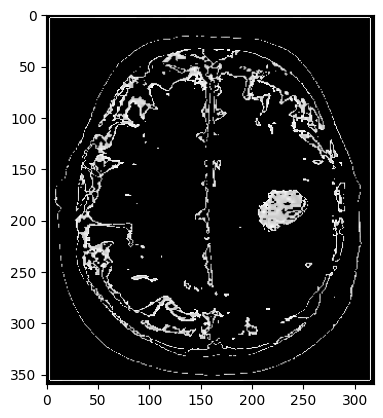

[76 76 76] [126 126 126]


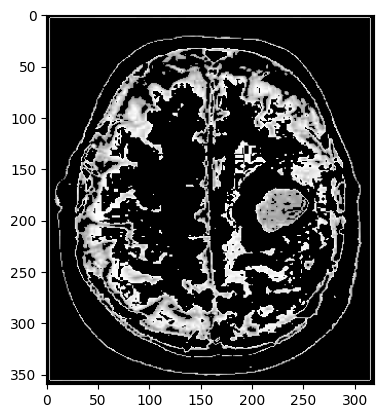

[76 76 76] [151 151 151]


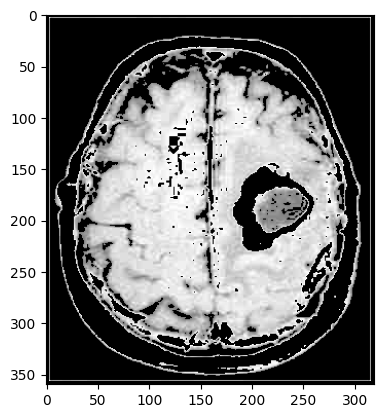

[76 76 76] [176 176 176]


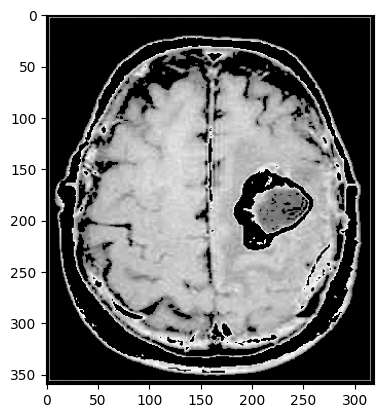

[76 76 76] [201 201 201]


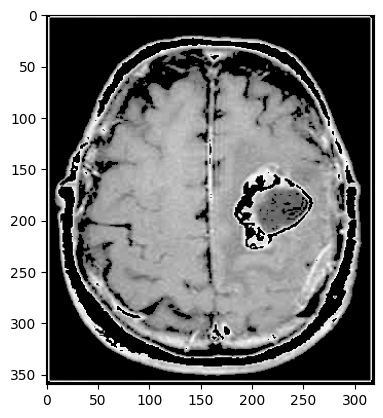

[76 76 76] [226 226 226]


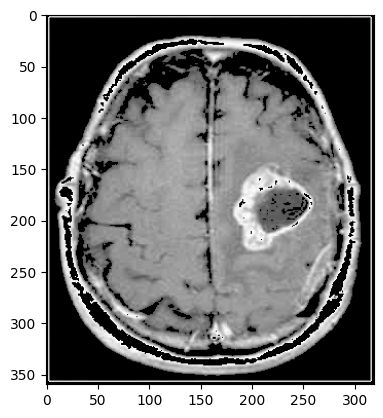

[76 76 76] [251 251 251]


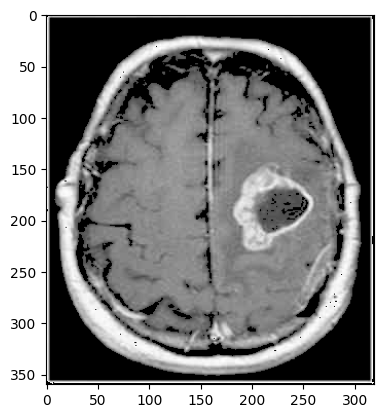

[101 101 101] [126 126 126]


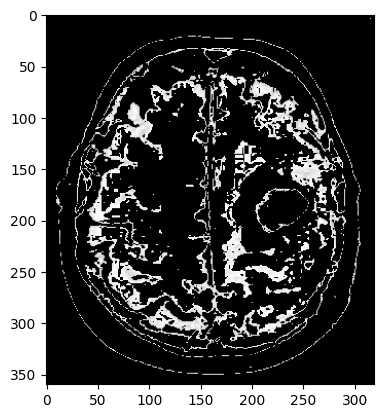

[101 101 101] [151 151 151]


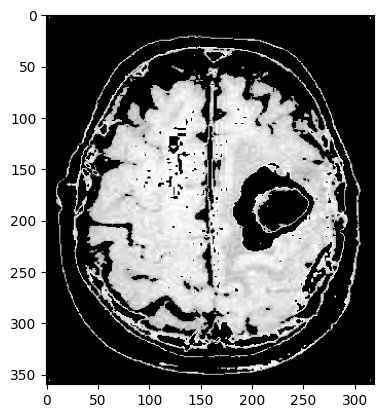

[101 101 101] [176 176 176]


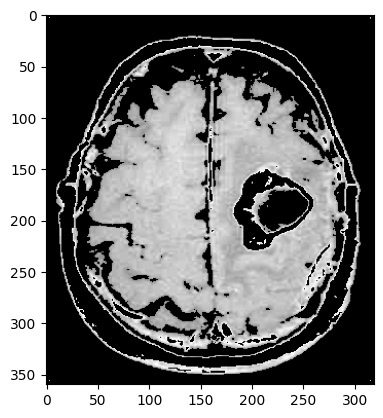

[101 101 101] [201 201 201]


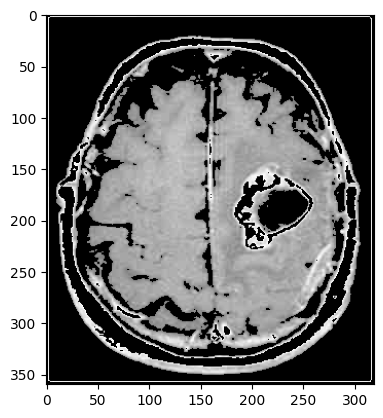

[101 101 101] [226 226 226]


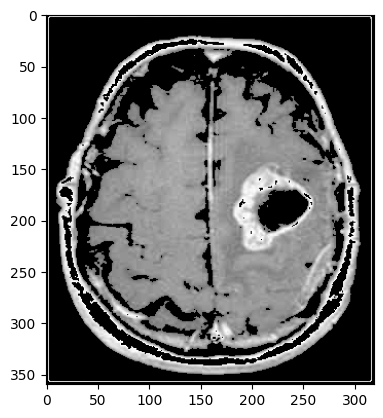

[101 101 101] [251 251 251]


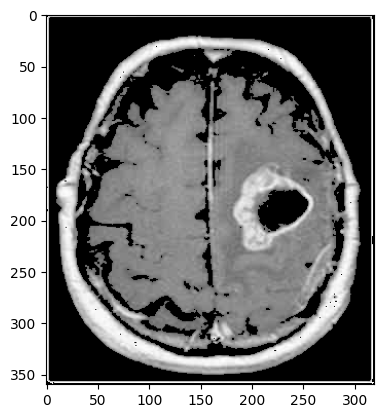

[126 126 126] [151 151 151]


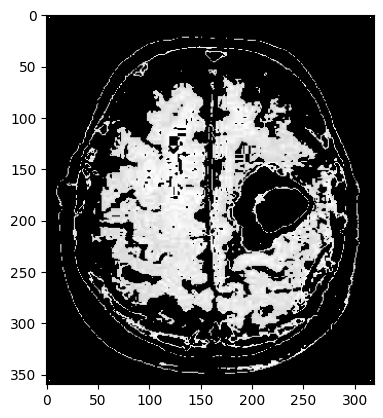

[126 126 126] [176 176 176]


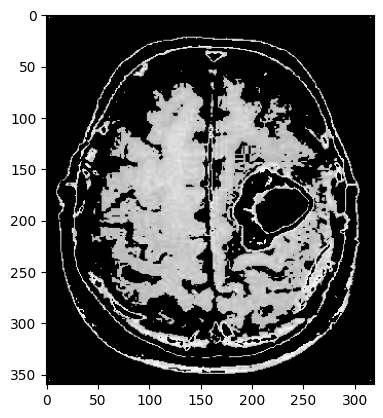

[126 126 126] [201 201 201]


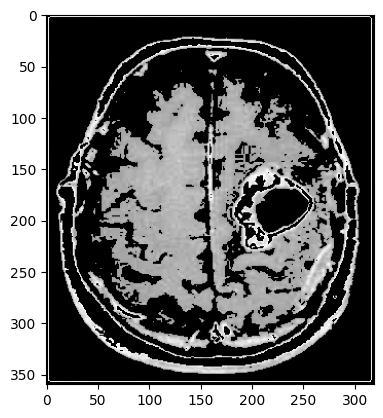

[126 126 126] [226 226 226]


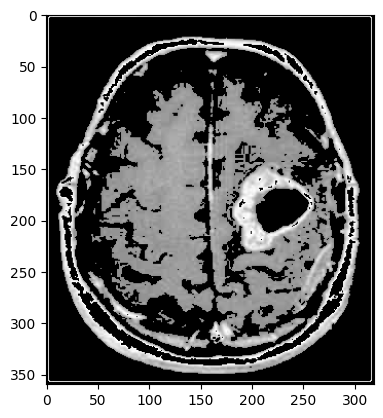

[126 126 126] [251 251 251]


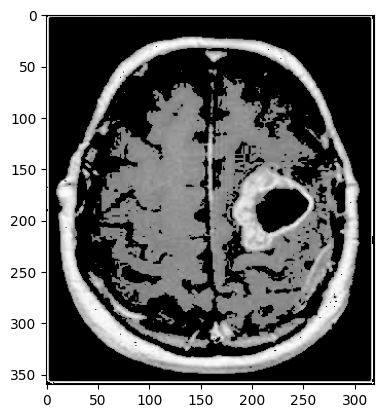

[151 151 151] [176 176 176]


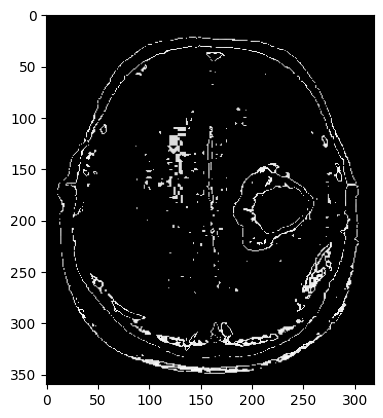

[151 151 151] [201 201 201]


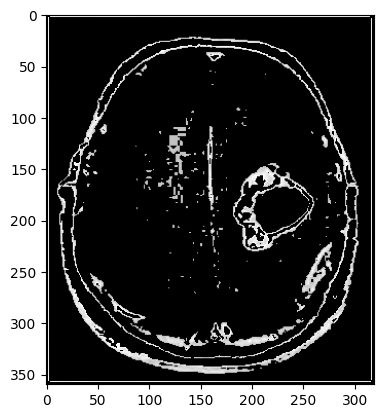

[151 151 151] [226 226 226]


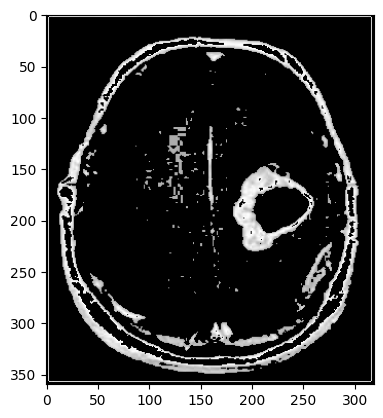

[151 151 151] [251 251 251]


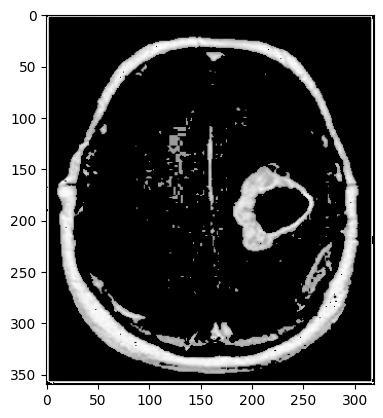

[176 176 176] [201 201 201]


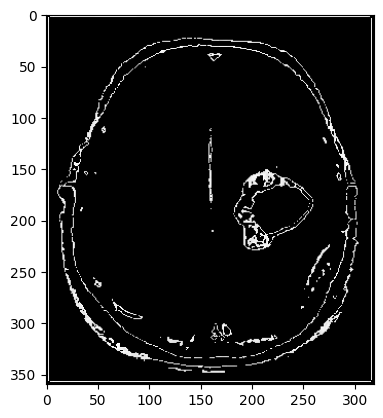

[176 176 176] [226 226 226]


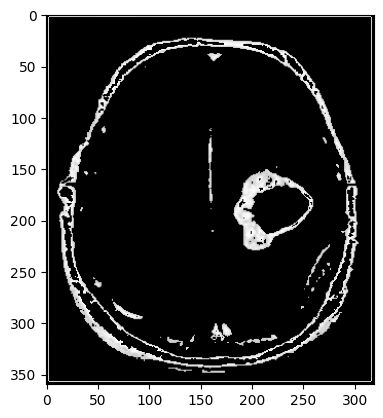

[176 176 176] [251 251 251]


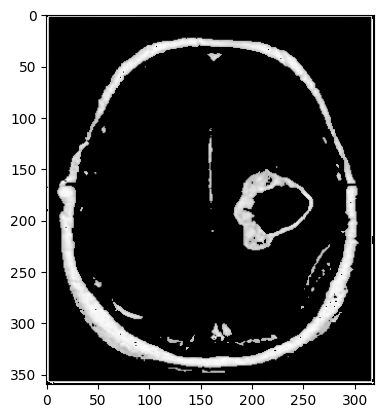

[201 201 201] [226 226 226]


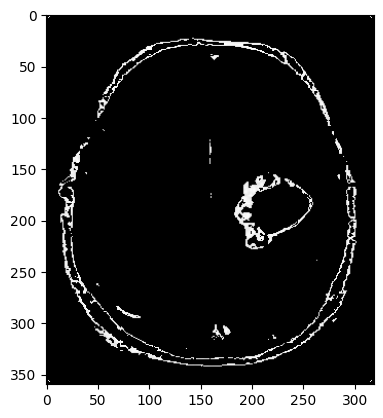

[201 201 201] [251 251 251]


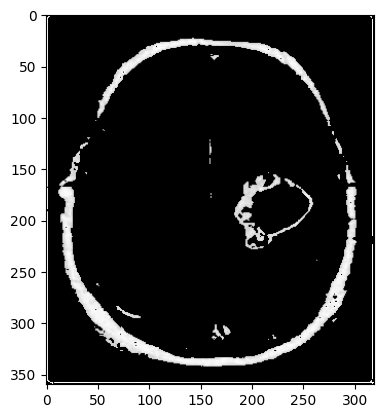

[226 226 226] [251 251 251]


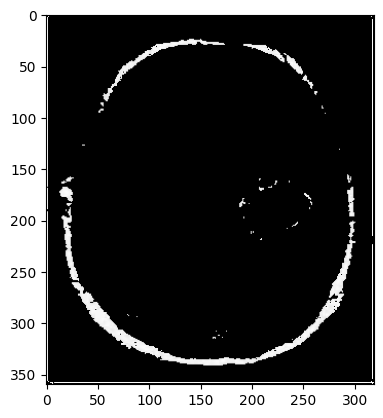

In [183]:
for  i in range(1,255,25):
    for  j in range(1,255,25):
        # Define the color bounds for green hue
        if j>i :
            lower = np.array([i, i, i])  # Adjust for specific green color range
            upper = np.array([j, j, j])  # Adjust for specific green color range
            print( lower , upper)
            segmented_image = segment_by_color_hsv(original_image, lower, upper)

            # Display the segmented image
            plt.imshow(segmented_image, cmap='gray')
            plt.show()



### <span style="color:blue; font-style:italic;"> the best combination are : lower , upper =  [201 201 201] , [251 251 251] </span>

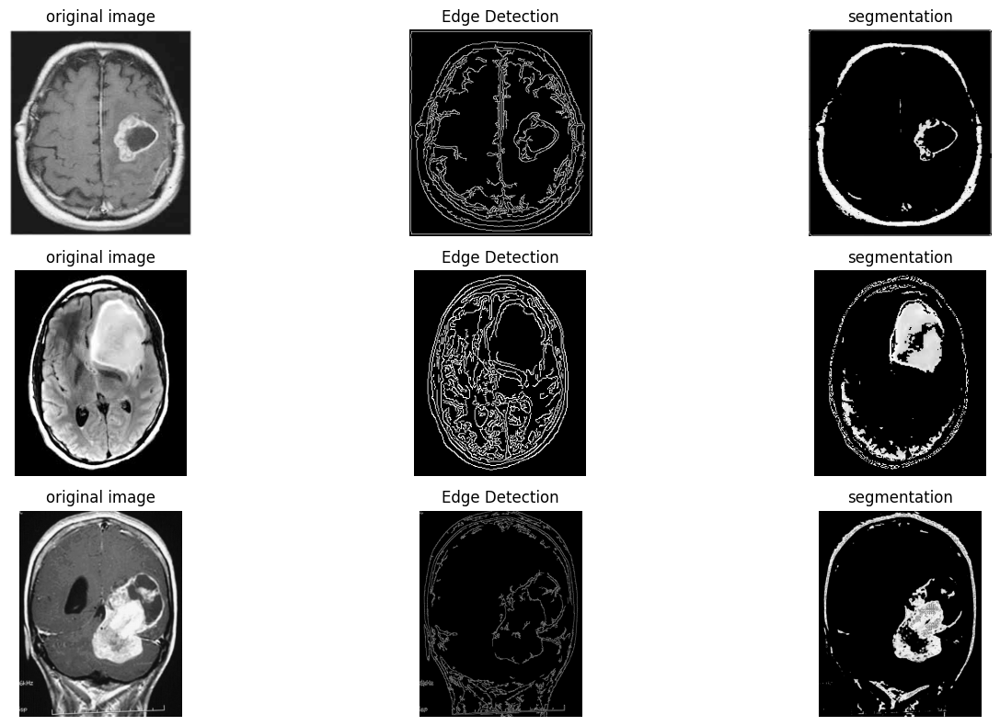

In [238]:
def segment_by_color_hsv(image, lower_bound, upper_bound):
    if len(image.shape) == 3 :
        image= image[:,:,1]
    hsv_image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    mask = cv2.inRange(hsv_image, lower_bound, upper_bound)
    segmented_image = cv2.bitwise_and(image, image, mask=mask)

    return segmented_image
def segment_by_color_hsv_list_imags(images, lower_bound, upper_bound):
    return [segment_by_color_hsv(im, lower_bound, upper_bound) for im in images ]

lower = np.array([201, 201, 201] )  # Adjust for specific green color range
upper = np.array([251 ,251, 251])  # Adjust for specific green color range
display_segmentation_results(s_images,segment_by_color_hsv_list_imags(s_images, lower, upper))


# <span style="color:red; font-style:italic; text-decoration:underline;"> C) - the result-testing </span>

In [272]:
lower = np.array([201, 201, 201] )  # Adjust for specific green color range
upper = np.array([251 ,251, 251]) 
segmented_image  =segment_by_color_hsv(s_images[2][:,:,1], lower, upper)
mask_path = 'data_brain/test_mask'
mask_images = [f for f in os.listdir(mask_path) if f.endswith(('.jpg', '.PNG', '.jpeg', '.gif'))]
mask_pa =  mask_path +'/'+ mask_images[1]
mask = cv2.imread(mask_pa, cv2.IMREAD_GRAYSCALE)

In [273]:
import cv2
import numpy as np

def calculate_jaccard_index(image, mask):
    # resize the images 
    width = min(image.shape[1], mask.shape[1])
    height = min(image.shape[0], mask.shape[0])
    image = cv2.resize(image, (width, height))
    mask = cv2.resize(mask, (width, height))
    # Ensure the image and mask have the same dimensions
    if image.shape != mask.shape:
        raise ValueError("Image and mask must have the same dimensions")
    # Calculate the intersection and union
    intersection = np.logical_and(image, mask)
    union = np.logical_or(image, mask)
    # Calculate the Jaccard Index (IoU)
    jaccard_index = np.sum(intersection) / np.sum(union)
    return jaccard_index


In [275]:
mask_path = 'data_brain/test_mask'
mask_images = [f for f in os.listdir(mask_path) if f.endswith(('.jpg', '.PNG', '.jpeg', '.gif'))]
for  i in range(len(mask_images)):
    mask_pat =  mask_path +'/'+ mask_images[i] 
    mask = cv2.imread(mask_pat, cv2.IMREAD_GRAYSCALE)
    jaccard_index = calculate_jaccard_index(proc, mask)
    print(f"Jaccard Index for mask{i}: {jaccard_index}")

Jaccard Index for mask1 : 0.003863092991065811
Jaccard Index for mask2 : 0.0038422502537335075
Jaccard Index for mask3 : 0.0
Jaccard Index for mask4 : 0.48422502537335075


In [274]:
jaccard_index = calculate_jaccard_index(proc, mask)
print(f"Jaccard Indexfor the mask1: {jaccard_index}")

Jaccard Index for mask1 : 0.48422502537335075


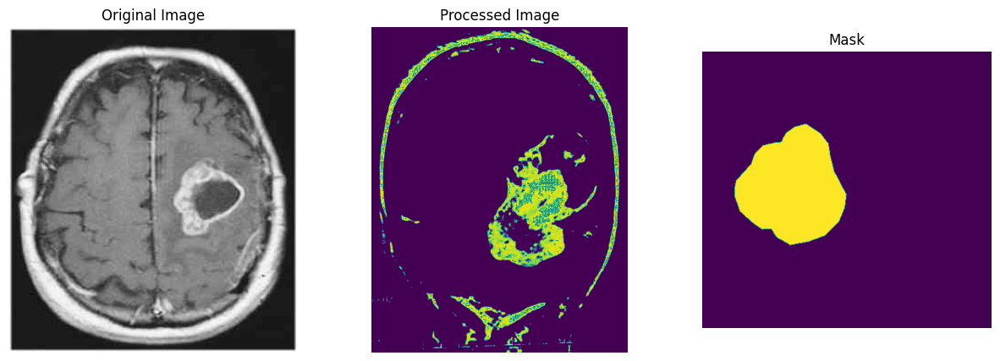

In [271]:

# Convert images to RGB format for proper display
image = s_images[0]
segmented_image  =segment_by_color_hsv(s_images[2][:,:,1], lower, upper)
mask_pa =  mask_path +'/'+ mask_images[4]
mask = cv2.imread(mask_pa, cv2.IMREAD_GRAYSCALE)
# Create a single line subplot
plt.figure(figsize=(15, 5))

# Display the original image
plt.subplot(1, 3, 1)
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')

# Display the processed image
plt.subplot(1, 3, 2)
plt.imshow(processed_image)
plt.title('Processed Image')
plt.axis('off')

# Display the mask
plt.subplot(1, 3, 3)
plt.imshow(mask)
plt.title('Mask')
plt.axis('off')

# Show the three images in one line
plt.show()
